In [2]:
import pandas as pd
import numpy as np
import os
import pickle
import json
import torch
from torch import nn
from torch.nn import functional as F
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import glob
import significantdigits as sig
import matplotlib.image as mpimg
import glob
from IPython.display import display
from IPython.display import Image as Im
from PIL import Image
from matplotlib.colors import LogNorm, Normalize
from matplotlib.ticker import MaxNLocator
from matplotlib.colors import TwoSlopeNorm
import matplotlib.patches as mpatches
import random
import nibabel as nib
from nilearn import plotting
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from scipy.stats import ttest_rel
from typing import Tuple
import matplotlib
import re
from concurrent.futures import ThreadPoolExecutor
import threading
from scipy import stats
import nilearn
from nilearn import masking, image
import scipy.ndimage as ndimage
from scipy.ndimage import gaussian_filter, binary_dilation

from nan_ops import NaNPool2d, NaNConv2d
from compute_similarity import load_and_conform_image, PSNR #getvol
# from pytorch_msssim import ssim, ms_ssim
from skimage.metrics import structural_similarity as ssim
from scipy.ndimage import gaussian_filter, binary_dilation


/lustre07/scratch/ine5/jupyter_nb/lib/python3.10/site-packages/torch/cuda/__init__.py:619: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


## Embeddings

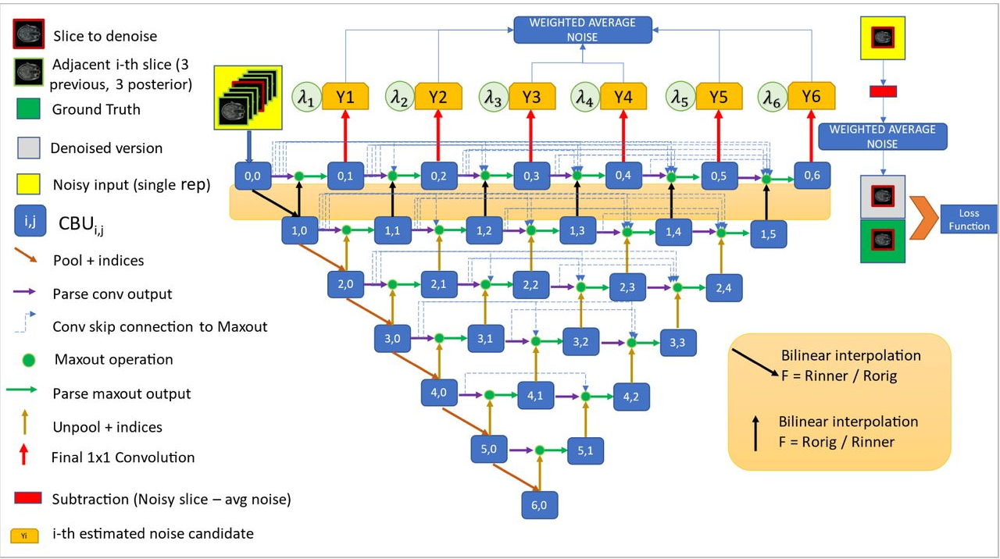

### Sanity Check

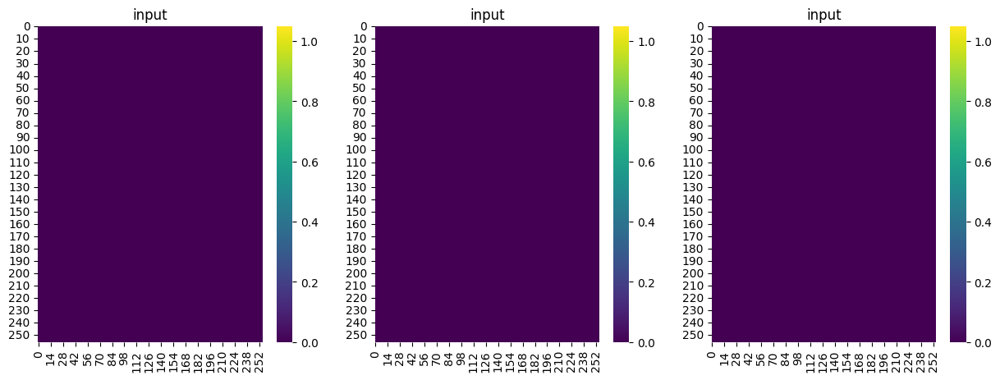

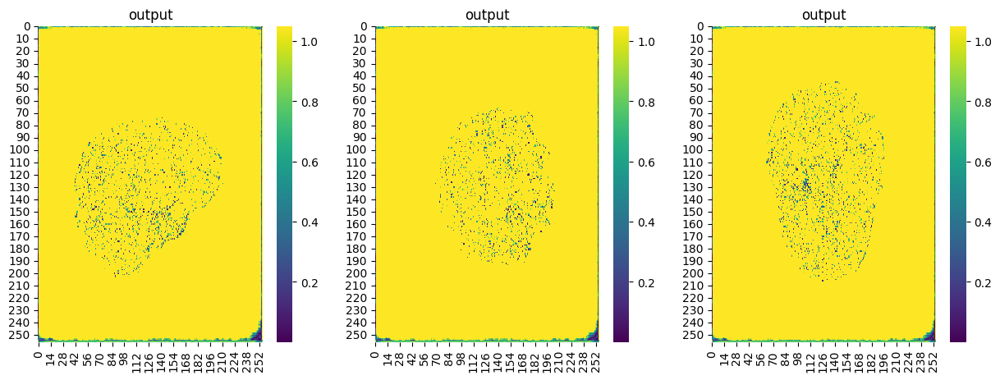

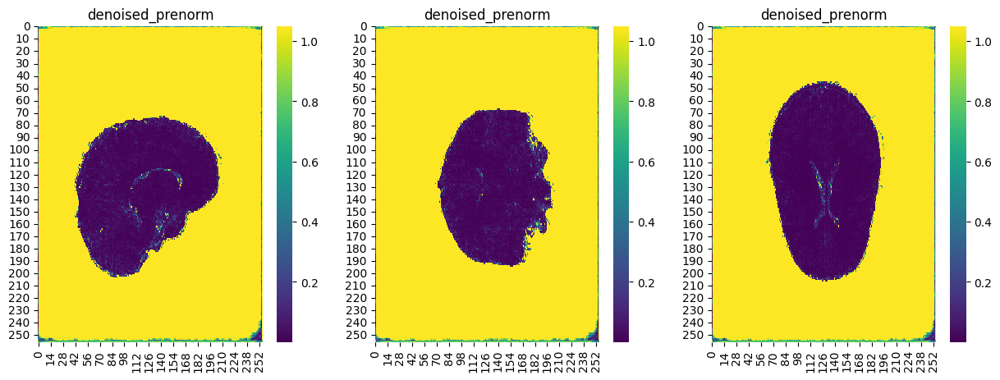

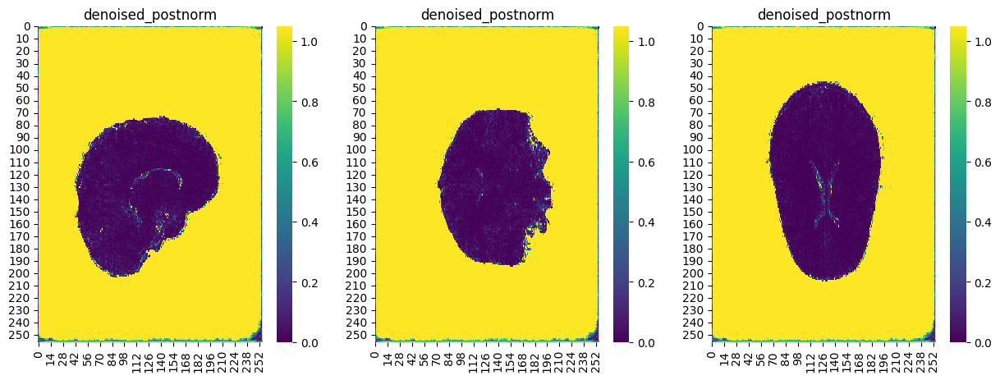

In [12]:
fig, axes = plt.subplots(1,3, figsize=(15,5))
for num, i in enumerate(['axial', 'sagittal', 'coronal']):
    input_ieee = pickle.load(open(f'/scratch/vinuyans/skips/embeddings/conv/ieee/{i}_input.pkl', 'rb'))
    input_thresh = pickle.load(open(f'/scratch/vinuyans/skips/embeddings/thresh05/processed/{i}_input.pkl', 'rb'))

    diff = np.abs ( (input_thresh - input_ieee + 1e-7) / (input_ieee  + 1e-7) )
    diff[diff == 1] = 0
    gc = sns.heatmap(diff.squeeze()[0], ax=axes[num], cmap='viridis', vmax=1.05)
    gc.set_title('input')

fig, axes = plt.subplots(1,3, figsize=(15,5))
for num, i in enumerate(['axial', 'sagittal', 'coronal']):
    output_ieee = pickle.load(open(f'/scratch/vinuyans/skips/embeddings/conv/ieee/{i}_output.pkl', 'rb'))
    output_thresh = pickle.load(open(f'/scratch/vinuyans/skips/embeddings/thresh05/processed/{i}_output.pkl', 'rb'))

    diff = np.abs ( (output_thresh - output_ieee + 1e-7) / (output_ieee + 1e-7) )
    diff[diff == 1] = 0
    gc = sns.heatmap(diff.squeeze()[0], ax=axes[num], cmap='viridis', vmax=1.05)
    gc.set_title('output')

fig, axes = plt.subplots(1,3, figsize=(15,5))
for num, i in enumerate(['axial', 'sagittal', 'coronal']):
    denoised_prenorm_ieee = pickle.load(open(f'/scratch/vinuyans/skips/embeddings/conv/ieee/{i}_denoised_prenorm.pkl', 'rb'))
    denoised_prenorm_thresh = pickle.load(open(f'/scratch/vinuyans/skips/embeddings/thresh05/processed/{i}_denoised_prenorm.pkl', 'rb'))

    diff = np.abs ( (denoised_prenorm_thresh - denoised_prenorm_ieee + 1e-7) / (denoised_prenorm_ieee + 1e-7) )
    diff[diff == 1] = 0
    gc = sns.heatmap(diff.squeeze()[0], ax=axes[num], cmap='viridis', vmax=1.05)
    gc.set_title('denoised_prenorm')

fig, axes = plt.subplots(1,3, figsize=(15,5))
for num, i in enumerate(['axial', 'sagittal', 'coronal']):
    denoised_postnorm_ieee = pickle.load(open(f'/scratch/vinuyans/skips/embeddings/conv/ieee/{i}_denoised_postnorm.pkl', 'rb'))
    denoised_postnorm_thresh = pickle.load(open(f'/scratch/vinuyans/skips/embeddings/thresh05/processed/{i}_denoised_postnorm.pkl', 'rb'))

    diff = np.abs ( (denoised_postnorm_thresh - denoised_postnorm_ieee + 1e-7) / (denoised_postnorm_ieee + 1e-7) )
    diff[diff == 1] = 0
    gc = sns.heatmap(diff.squeeze()[0], ax=axes[num], cmap='viridis', vmax=1.05)
    gc.set_title('denoised_postnorm')


### Visualize Embeddings Across Thresholds

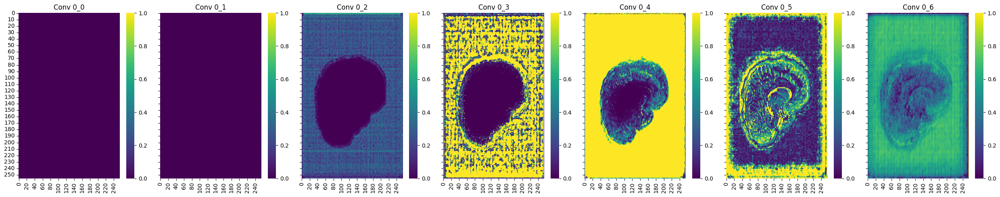

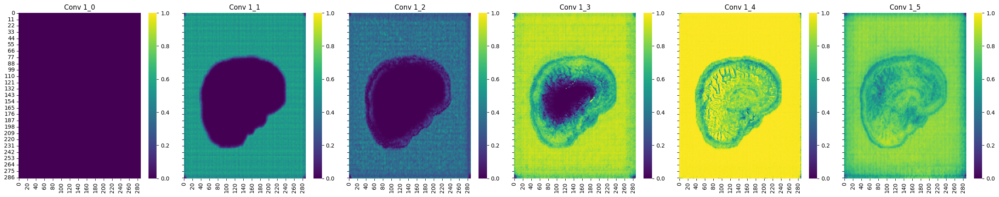

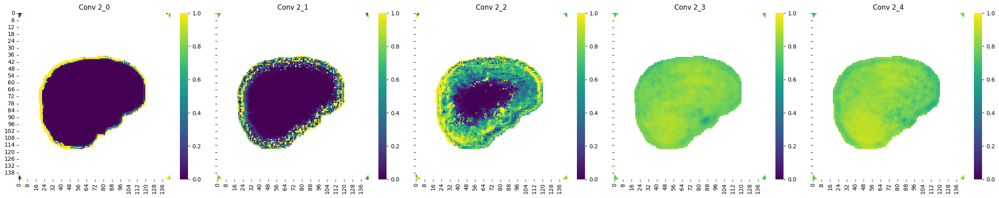

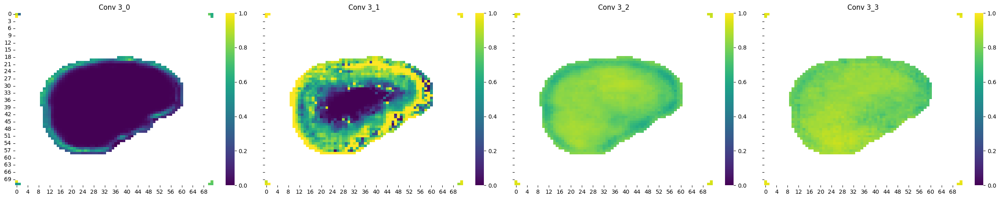

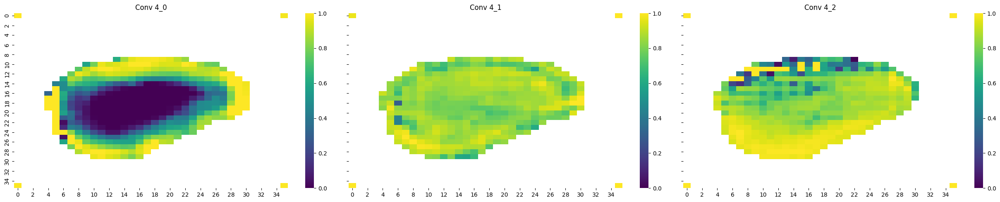

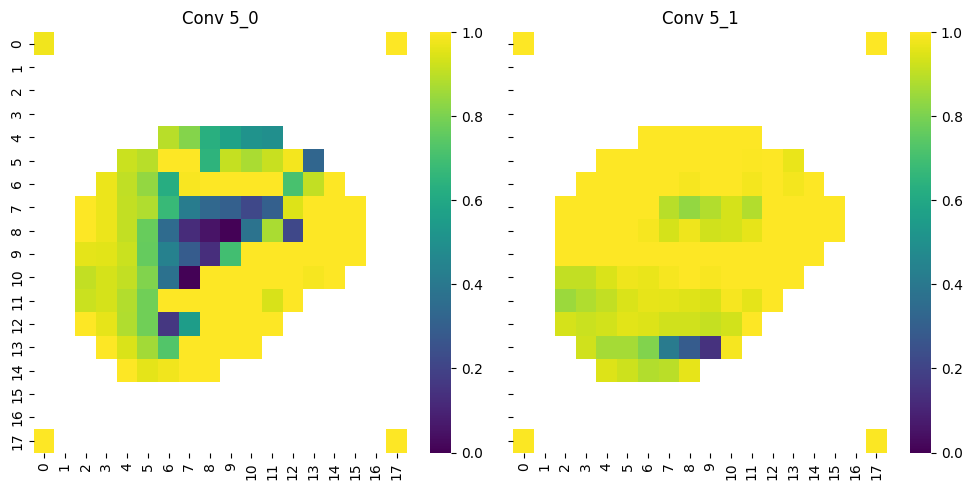

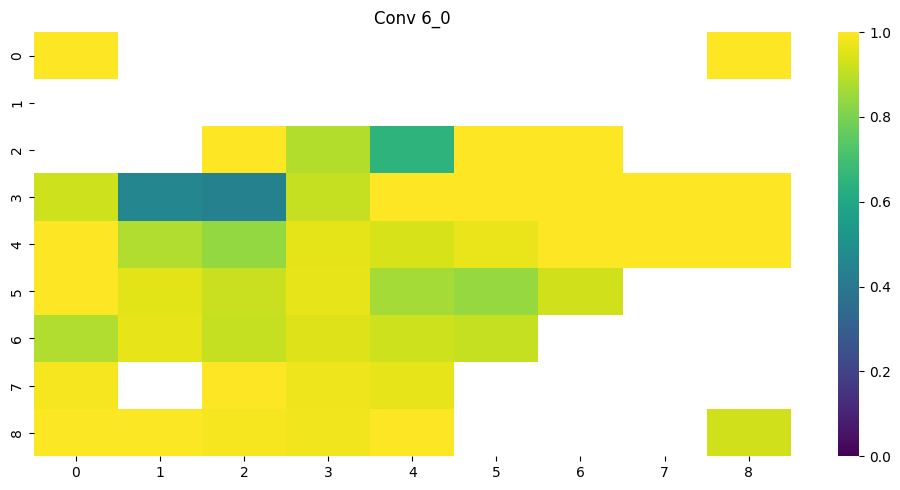

In [17]:
def graph_conv(filedir, plane, cut):
    n = 7  # Number of rows in the pyramid

    for i in range(n):  # Start from n down to 1
        
        if i > 4:
            fig, axes = plt.subplots(1,(n-i), figsize=(10,5), sharey=True)            
        else:
            fig, axes = plt.subplots(1,(n-i), figsize=(25,5), sharey=True)

        for k in range(n-i):

            conv = pickle.load(open(f"{filedir}/thresh05/{plane}_{i}_{k}.pkl",'rb'))
            ieee = pickle.load(open(f"{filedir}/ieee/{plane}_{i}_{k}.pkl",'rb'))

            diff = np.abs( (conv - ieee) / ieee )
            if i==6 and k == 0:
                gc = sns.heatmap(diff[0][cut], ax=axes, vmin=0, vmax=1, cmap='viridis')
                
            else:
                gc = sns.heatmap(diff[0][cut], ax=axes[k], vmin=0, vmax=1, cmap='viridis')
            gc.set_title(f"Conv {i}_{k}")

        # Move to the next line after each row
        plt.tight_layout()

graph_conv('/scratch/vinuyans/skips/embeddings/conv', plane='axial', cut=10)

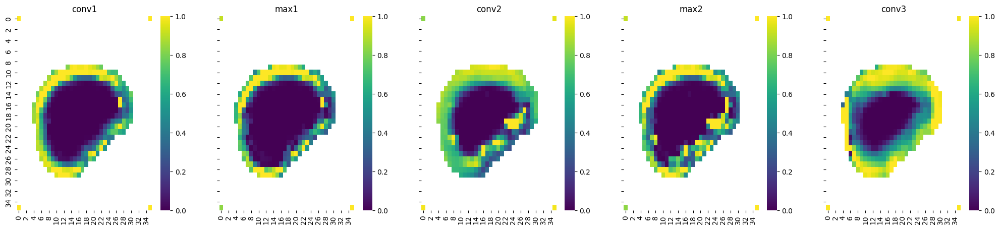

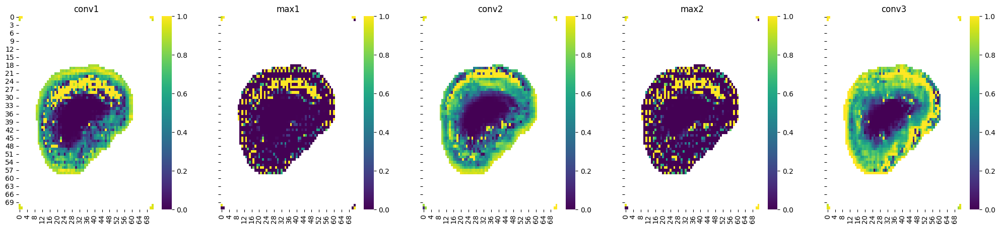

In [2]:
def get_inner_block(filedir, plane, cut, ieee_flag, i, j):

    fig, axes = plt.subplots(1,5, figsize=(25,5), sharey=True)

    for num, layer in enumerate(['conv1', 'max1', 'conv2', 'max2', 'conv3']):

        conv = pickle.load(open(f"{filedir}/thresh05/{plane}_{i}_{j}_{layer}{ieee_flag}.pkl",'rb'))
        ieee = pickle.load(open(f"{filedir}/ieee/{plane}_{i}_{j}_{layer}.pkl",'rb'))
        # print(conv.shape, ieee.shape)

        diff = np.abs( ((conv - ieee) + 1e-7) / ieee )
        diff = diff.masked_fill(torch.isinf(diff), 0)

        gc = sns.heatmap(diff[0][cut], ax=axes[num], cmap='viridis', vmin=0, vmax=1)
            
        gc.set_title(f"{layer}")

    
get_inner_block('/scratch/vinuyans/skips/embeddings/conv', plane='axial', cut=10, ieee_flag='', i='4', j='0')
# get_inner_block('/scratch/vinuyans/skips/embeddings/conv', plane='axial', cut=10, ieee_flag='_vieee', i='4', j='0')
get_inner_block('/scratch/vinuyans/skips/embeddings/conv', plane='axial', cut=10, ieee_flag='', i='3', j='1')


In [2]:
def graph_arch(name, cmap, nan_root, plane, cut, min = None, max = None):
    num_rows = 8
    padding = 0.02

    # Create a figure
    fig = plt.figure(figsize=(30, 25))

    num_cols = 6
    total_width = num_cols / num_rows
    total_width_with_padding = total_width + (num_cols - 1) * padding
    left_start = (1 - total_width_with_padding) / 2
    for col in range(6):
        # Calculate the subplot position with padding
        left = left_start + col * (1 / num_rows + padding)
        bottom = (num_rows  - 1) / num_rows  # Reverse the row position
        width = 1 / num_rows - padding
        height = 1 / num_rows - padding
        
        # Add subplot with the calculated position
        ax = fig.add_axes([left, bottom, width, height])
        ax.set_visible(True)

    # Plot heatmaps in a reverse pyramid shape with padding
    for row in range(num_rows):
        if row != 0:
            num_cols = num_rows - row
            total_width = num_cols / num_rows
            total_width_with_padding = total_width + (num_cols - 1) * padding
            left_start = (1 - total_width_with_padding) / 2
            
            for col in range(num_cols):
                # Calculate the subplot position with padding
                left = left_start + col * (1 / num_rows + padding)
                bottom = (num_rows - row - 1) / num_rows  # Reverse the row position
                width = 1 / num_rows - padding
                height = 1 / num_rows - padding
                
                # Add subplot with the calculated position
                ax = fig.add_axes([left, bottom, width, height])
                ax.set_visible(True)
                

    # Plot Y graphs 
    idx =0
    for i in range(1,7):
        a=pickle.load(open(f'{nan_root}/{plane}_y{i}.pkl', 'rb'))[0]
        # ieee=pickle.load(open(f'{ieee_root}/y{i}.pkl', 'rb'))
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(a.squeeze(), cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        
        gc.set_title(f'y{i}')
        idx += 1

    # Plot 1_X graphs
    # Plot single 0_0 with 1_X row
    a=pickle.load(open(f'{nan_root}/{plane}_0_0_base_output.pkl', 'rb'))[0]
    # ieee=pickle.load(open(f'{ieee_root}/0_0_base_output.pkl', 'rb'))[0]
    # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
    gc = sns.heatmap(a.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
    
    gc.set_title(f'0_0_base_output')
    idx += 1

    for i in range(6):
        # if i == 0: continue
        a=pickle.load(open(f'{nan_root}/{plane}_1_{i}_bilinear.pkl', 'rb'))[0]
        # ieee=pickle.load(open(f'{ieee_root}/1_{i}_bilinear.pkl', 'rb'))[0]
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        # print(f'{nan_root}/{plane}_1_{i}_bilinear.pkl', 'rb')
        gc = sns.heatmap(a.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        gc.set_title(f'1_{i}_bilinear')
        idx += 1

    # Plot Pool & unpool graphs
    for i in range(1,6):
        a=pickle.load(open(f'{nan_root}/{plane}_{i}_0_pool.pkl', 'rb'))[0]
        # ieee=pickle.load(open(f'{ieee_root}/{i}_0_pool.pkl', 'rb'))[0]
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(a.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        
        gc.set_title(f'{i}_0_pool')
        idx += 1
        for j in range(6-i):
            a=pickle.load(open(f'{nan_root}/{plane}_{i+1}_{j}_unpool.pkl', 'rb'))[0]
            # ieee=pickle.load(open(f'{ieee_root}/{i+1}_{j}_unpool.pkl', 'rb'))[0]
            gc = sns.heatmap(a.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
            
            gc.set_title(f'{i+1}_{j}_unpool')
            idx += 1
    fig.axes[idx].set_visible(False)

    plt.suptitle(name, y=1.02, fontsize=15);
    # Show the plot
    plt.show()



def graph_arch_relerr(name, cmap, nan_root, ieee_root, plane, cut, min = None, max = None):
    num_rows = 8
    padding = 0.02

    # Create a figure
    fig = plt.figure(figsize=(30, 25))

    num_cols = 6
    total_width = num_cols / num_rows
    total_width_with_padding = total_width + (num_cols - 1) * padding
    left_start = (1 - total_width_with_padding) / 2
    for col in range(6):
        # Calculate the subplot position with padding
        left = left_start + col * (1 / num_rows + padding)
        bottom = (num_rows  - 1) / num_rows  # Reverse the row position
        width = 1 / num_rows - padding
        height = 1 / num_rows - padding
        
        # Add subplot with the calculated position
        ax = fig.add_axes([left, bottom, width, height])
        ax.set_visible(True)

    # Plot heatmaps in a reverse pyramid shape with padding
    for row in range(num_rows):
        if row != 0:
            num_cols = num_rows - row
            total_width = num_cols / num_rows
            total_width_with_padding = total_width + (num_cols - 1) * padding
            left_start = (1 - total_width_with_padding) / 2
            
            for col in range(num_cols):
                # Calculate the subplot position with padding
                left = left_start + col * (1 / num_rows + padding)
                bottom = (num_rows - row - 1) / num_rows  # Reverse the row position
                width = 1 / num_rows - padding
                height = 1 / num_rows - padding
                
                # Add subplot with the calculated position
                ax = fig.add_axes([left, bottom, width, height])
                ax.set_visible(True)
                

    # Plot Y graphs 
    idx =0
    for i in range(1,7):
        a=pickle.load(open(f'{nan_root}/{plane}_y{i}.pkl', 'rb'))[0]
        ieee=pickle.load(open(f'{ieee_root}/{plane}_y{i}.pkl', 'rb'))
        diff_rel = ( (ieee - a)/ieee ).nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(diff_rel.squeeze()[0], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        
        gc.set_title(f'y{i}')
        idx += 1

    # Plot 1_X graphs
    # Plot single 0_0 with 1_X row
    a=pickle.load(open(f'{nan_root}/{plane}_0_0_base_output.pkl', 'rb'))[0]
    ieee=pickle.load(open(f'{ieee_root}/{plane}_0_0_base_output.pkl', 'rb'))[0]
    diff_rel = ( (ieee - a)/ieee ).nan_to_num(nan=-1, posinf=2)
    gc = sns.heatmap(diff_rel.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
    
    gc.set_title(f'0_0_base_output')
    idx += 1

    for i in range(6):
        # if i == 0: continue
        a=pickle.load(open(f'{nan_root}/{plane}_1_{i}_bilinear.pkl', 'rb'))[0]
        ieee=pickle.load(open(f'{ieee_root}/{plane}_1_{i}_bilinear.pkl', 'rb'))[0]
        diff_rel = ( (ieee - a)/ieee ).nan_to_num(nan=-1, posinf=2)
        # print(f'{nan_root}/{plane}_1_{i}_bilinear.pkl', 'rb')
        gc = sns.heatmap(diff_rel.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        gc.set_title(f'1_{i}_bilinear')
        idx += 1

    # Plot Pool & unpool graphs
    for i in range(1,6):
        a=pickle.load(open(f'{nan_root}/{plane}_{i}_0_pool.pkl', 'rb'))[0]
        ieee=pickle.load(open(f'{ieee_root}/{plane}_{i}_0_pool.pkl', 'rb'))[0]
        print(a.shape, ieee.shape)
        diff_rel = ( (ieee - a)/ieee ).nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(diff_rel.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        
        gc.set_title(f'{i}_0_pool')
        idx += 1
        for j in range(6-i):
            a=pickle.load(open(f'{nan_root}/{plane}_{i+1}_{j}_unpool.pkl', 'rb'))[0]
            ieee=pickle.load(open(f'{ieee_root}/{plane}_{i+1}_{j}_unpool.pkl', 'rb'))[0]
            diff_rel = ( (ieee - a)/ieee ).nan_to_num(nan=-1, posinf=2)
            gc = sns.heatmap(diff_rel.squeeze()[cut], cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
            
            gc.set_title(f'{i+1}_{j}_unpool')
            idx += 1
    fig.axes[idx].set_visible(False)

    plt.suptitle(name, y=1.02, fontsize=15);
    # Show the plot
    plt.show()


#### Raw Images

**Threshold 0.75**

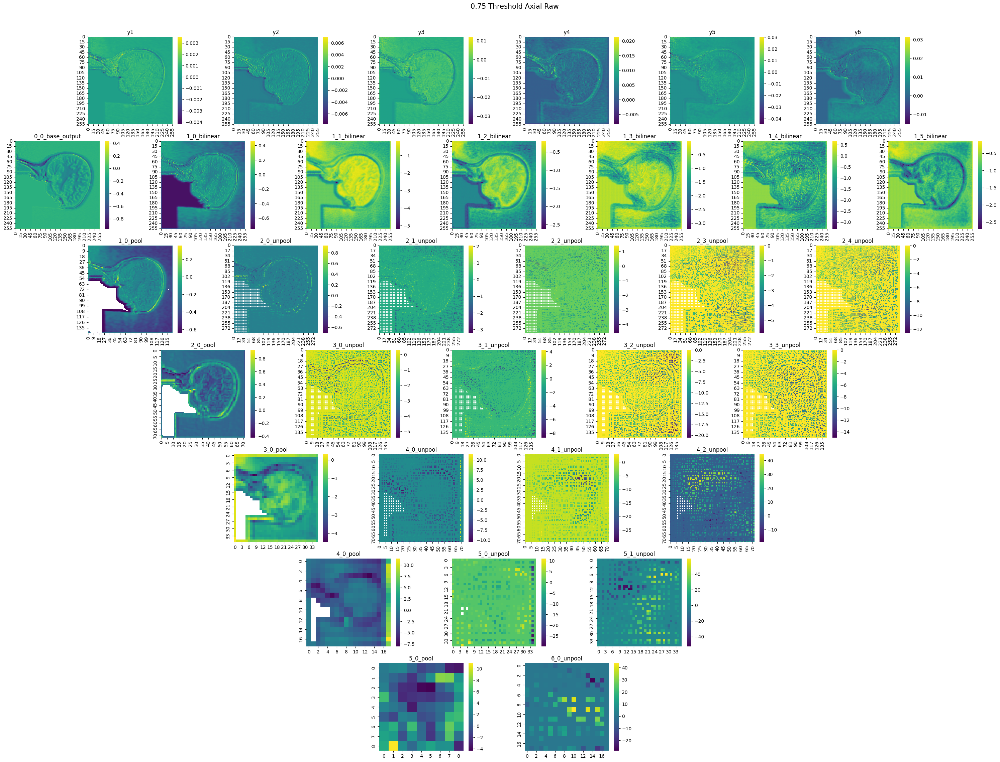

In [27]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh075/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.75 Threshold Axial Raw', cmap, nan_root, 'axial', 10)


**Threshold 0.3**

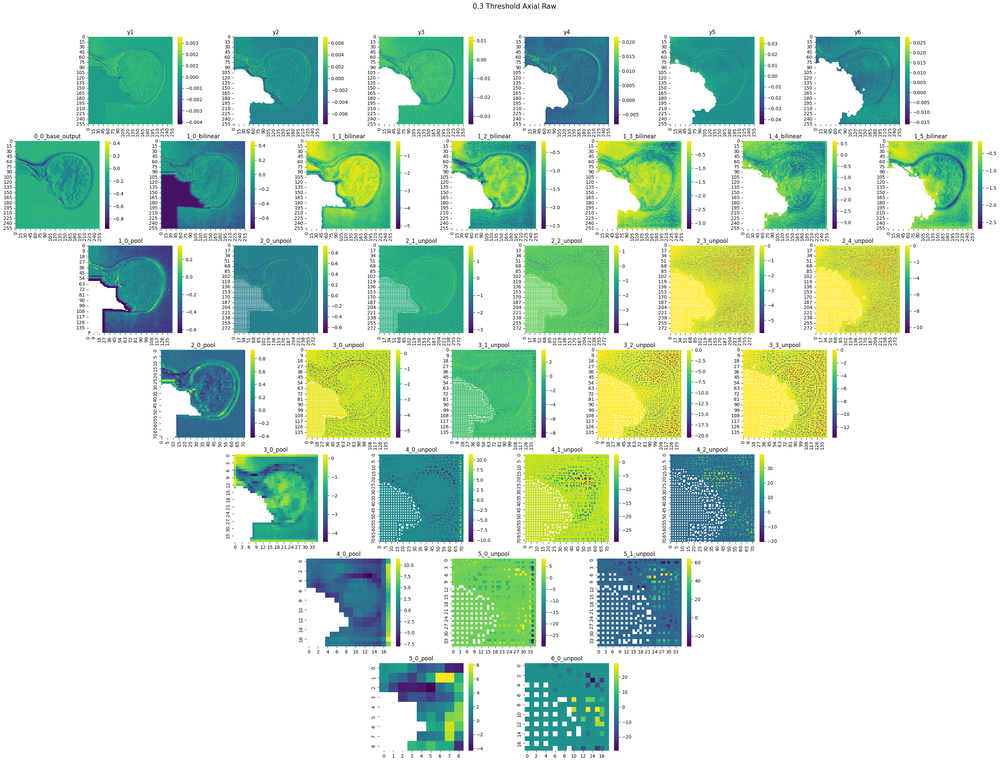

In [26]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh03/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.3 Threshold Axial Raw', cmap, nan_root, 'axial', 10)


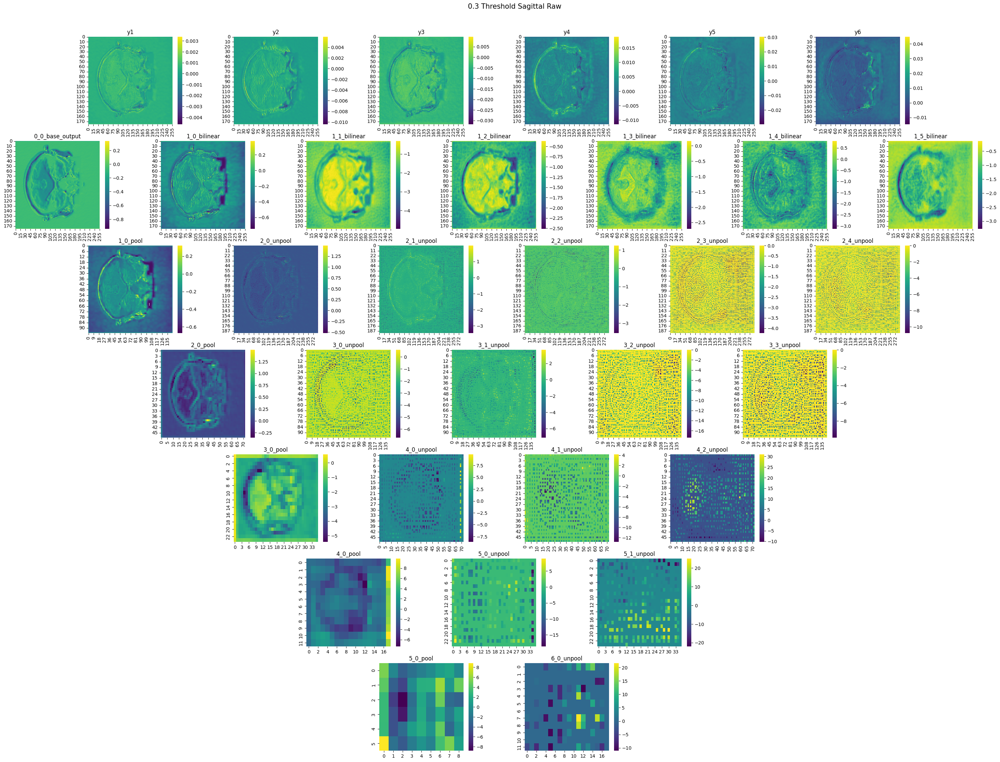

In [51]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh03/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.3 Threshold Sagittal Raw', cmap, nan_root, 'sagittal', 10)


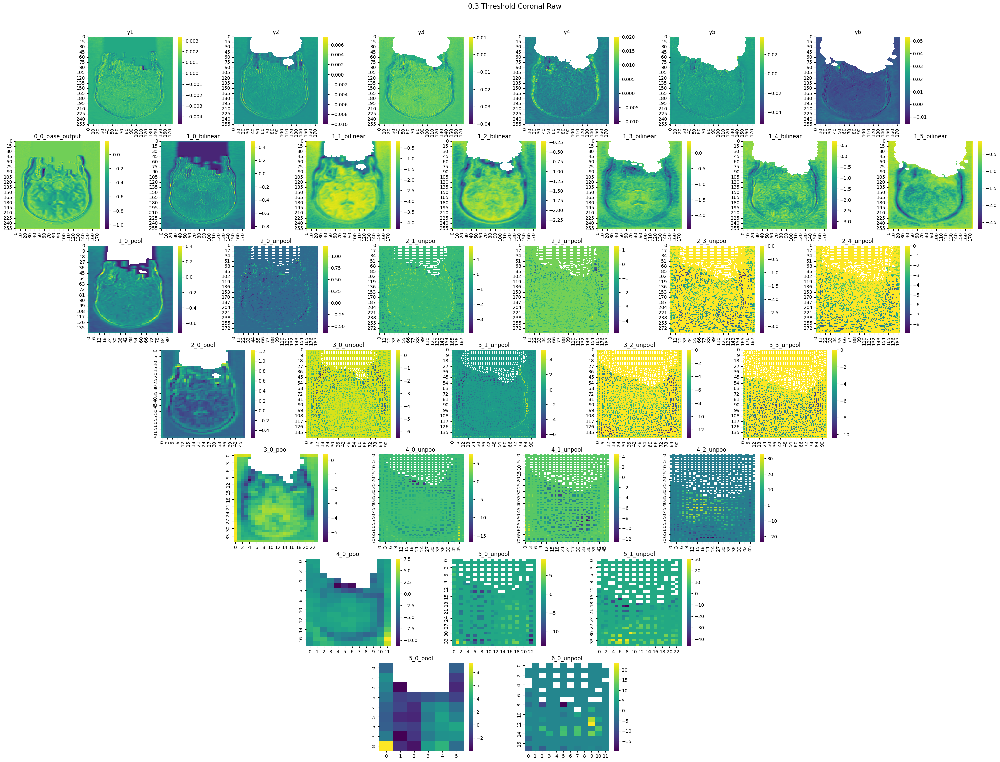

In [50]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh03/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.3 Threshold Coronal Raw', cmap, nan_root, 'coronal', 10)


**Threshold 0.4**

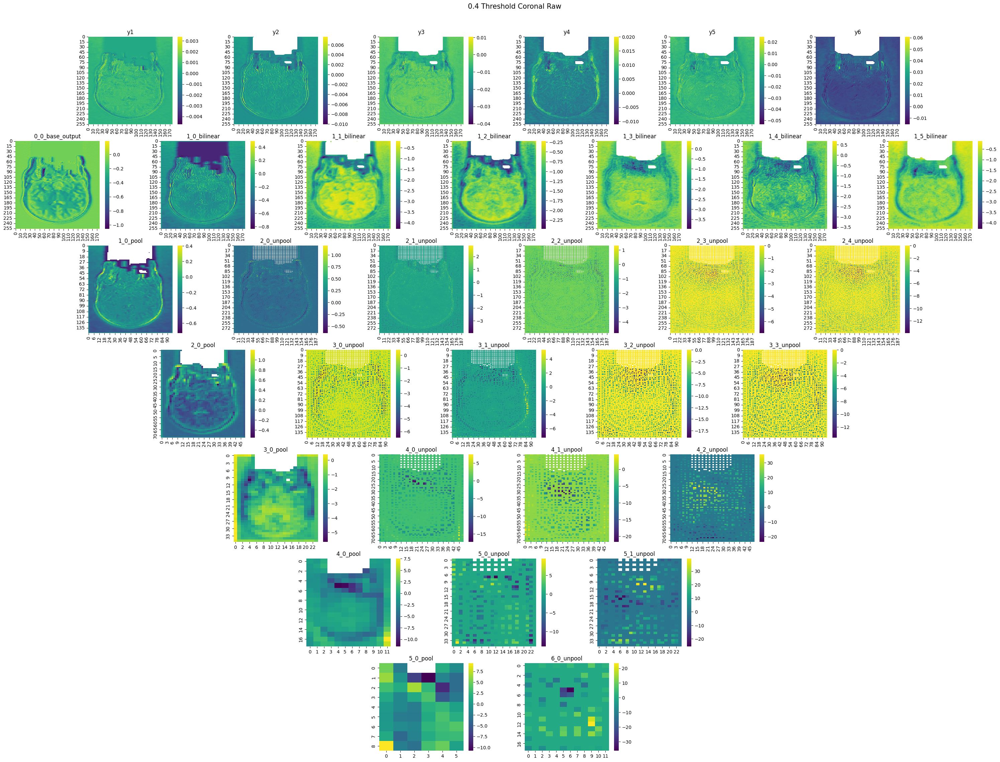

In [3]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh04/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.4 Threshold Coronal Raw', cmap, nan_root, 'coronal', 10)

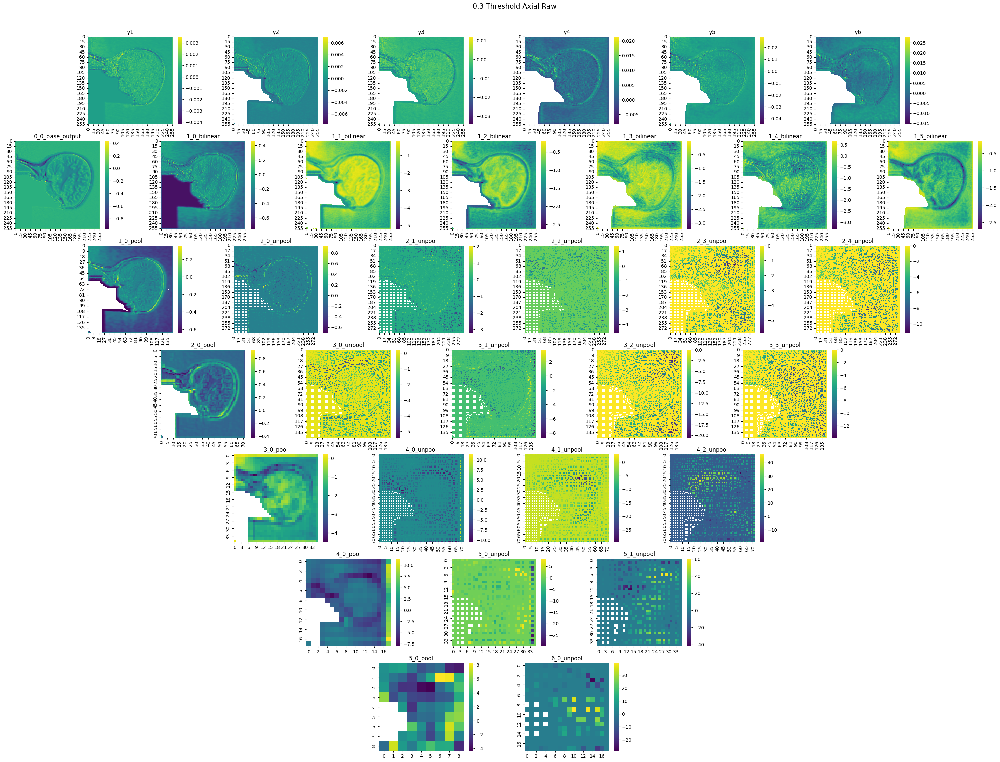

In [10]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh04/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.3 Threshold Axial Raw', cmap, nan_root, 'axial', 10)


**Threshold 0.5**

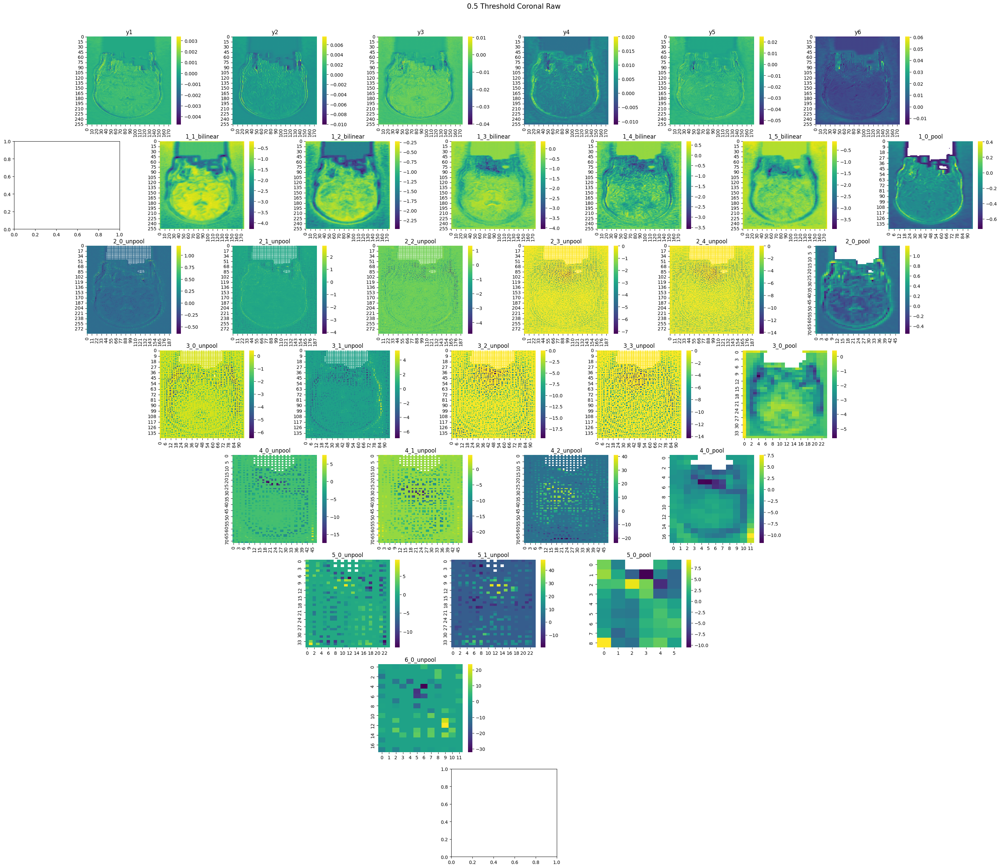

In [18]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh05/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.5 Threshold Coronal Raw', cmap, nan_root, 'coronal', 10)


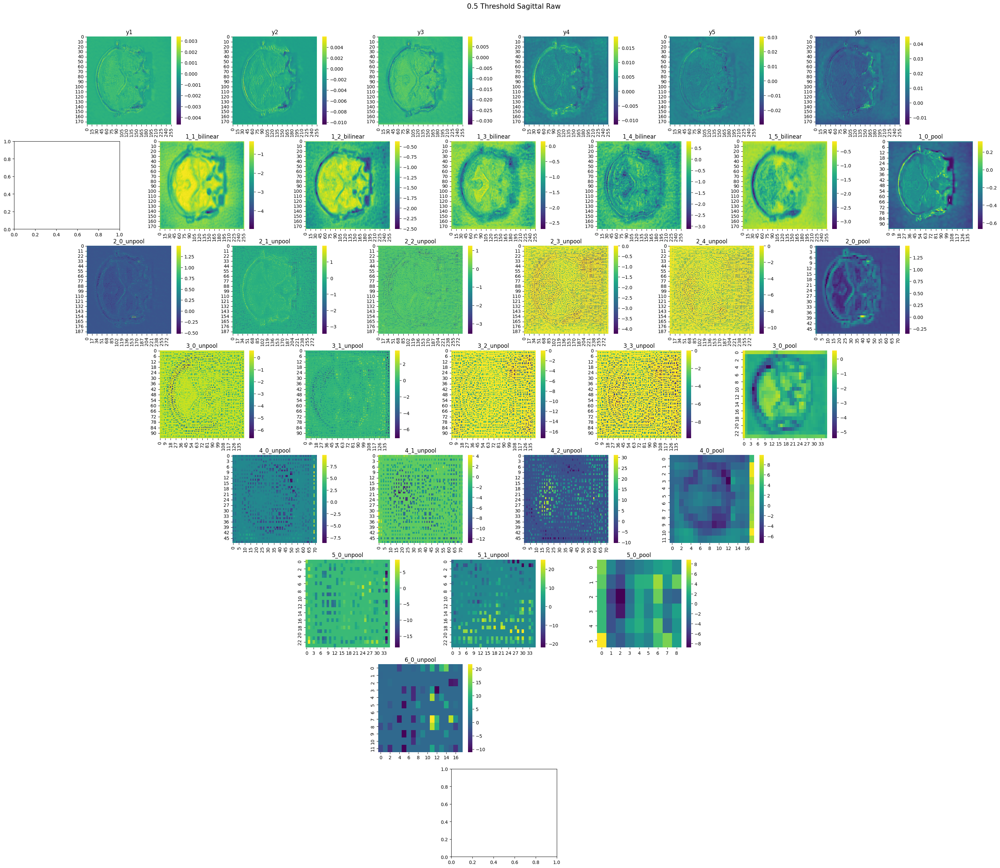

In [17]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh05/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.5 Threshold Sagittal Raw', cmap, nan_root, 'sagittal', 10)


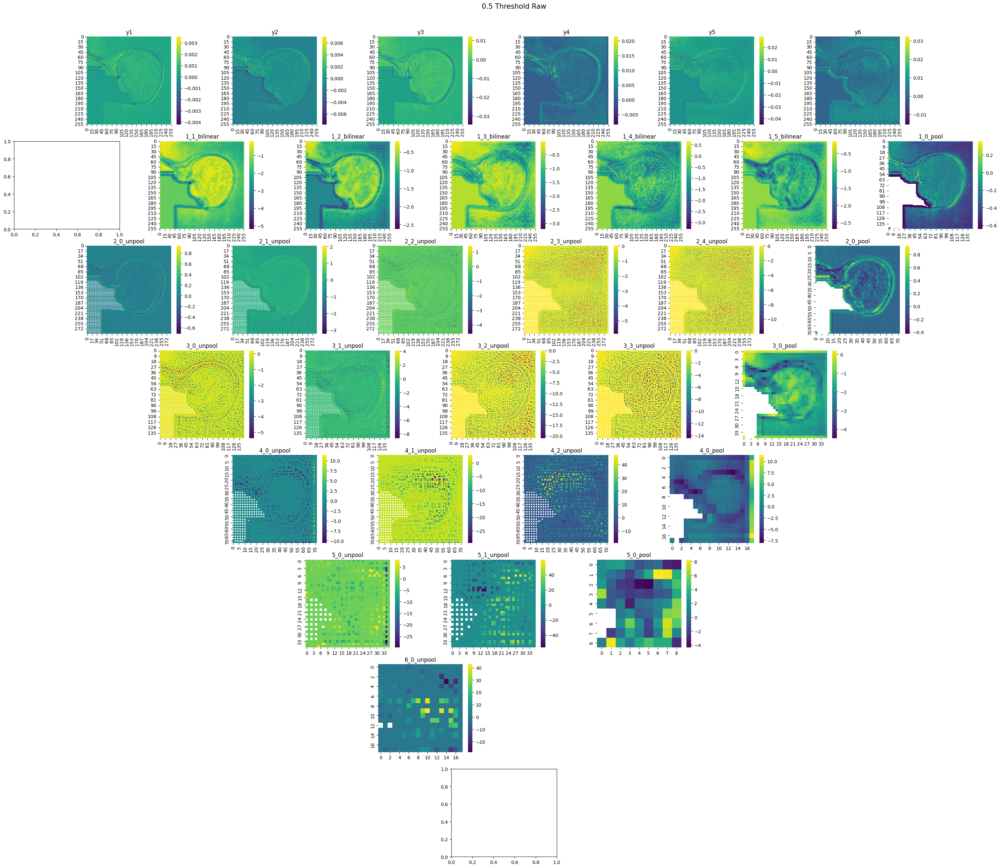

In [12]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh05/raw'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.5 Threshold Axial Raw', cmap, nan_root, 'axial', 10)


#### Processed

**IEEE**

torch.Size([64, 144, 144]) torch.Size([64, 144, 144])


/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N


torch.Size([64, 72, 72]) torch.Size([64, 72, 72])


/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N


torch.Size([64, 36, 36]) torch.Size([64, 36, 36])


/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N


torch.Size([64, 18, 18]) torch.Size([64, 18, 18])


/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N


torch.Size([64, 9, 9]) torch.Size([64, 9, 9])


/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N
/home/ine5/dynamo_env/lib/python3.10/site-packages/matplotlib/colors.py:718: RuntimeWarning: overflow encountered in multiply
  xa *= self.N


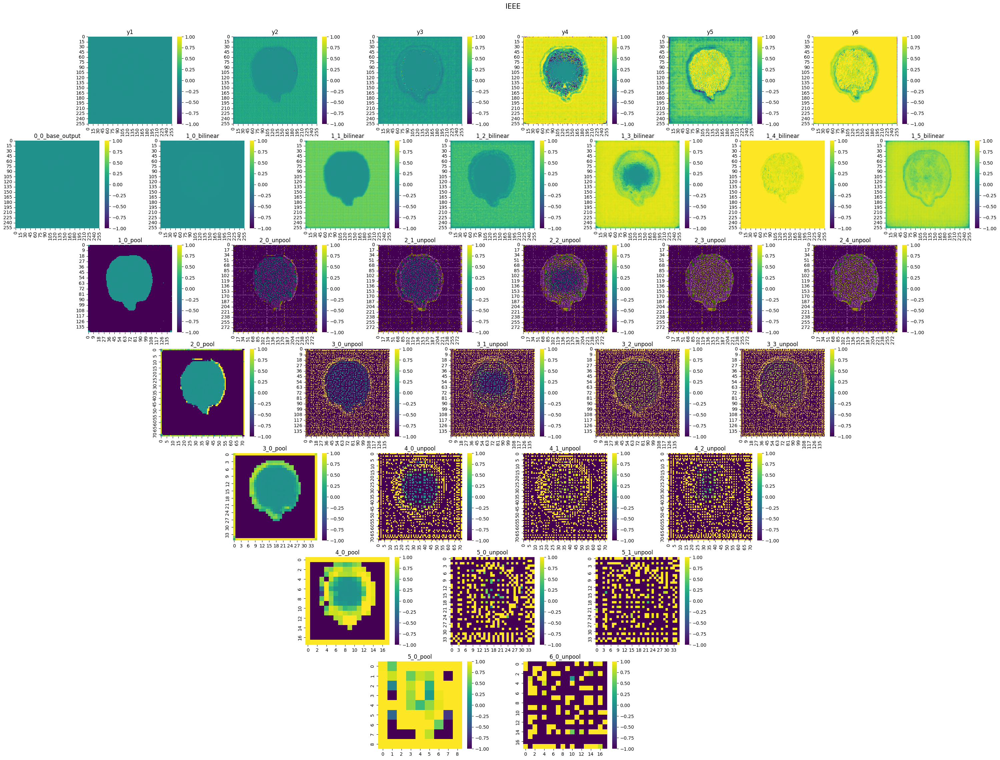

In [4]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh075/processed'
ieee_root = '/scratch/vinuyans/skips/embeddings/ieee/processed'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch_relerr('IEEE', cmap, nan_root, ieee_root, 'coronal', 10, min=-1, max=1)


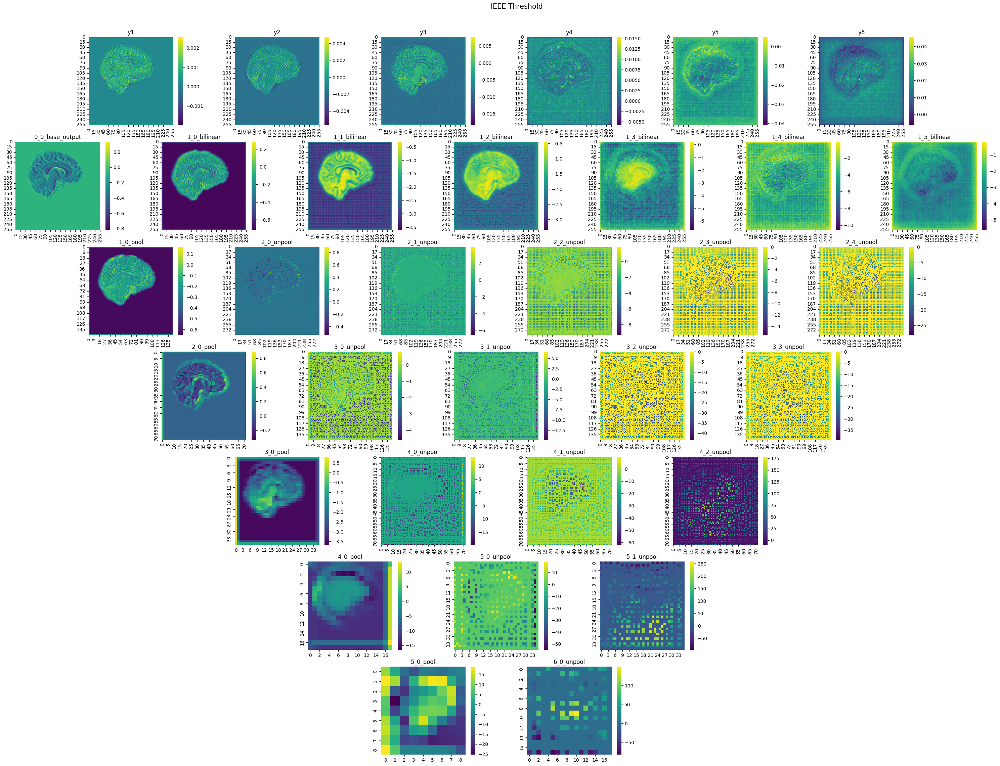

In [6]:
nan_root = '/scratch/vinuyans/skips/embeddings/ieee/processed'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('IEEE Threshold', cmap, nan_root, 'axial', 10)


**Threshold 0.75 Processed**

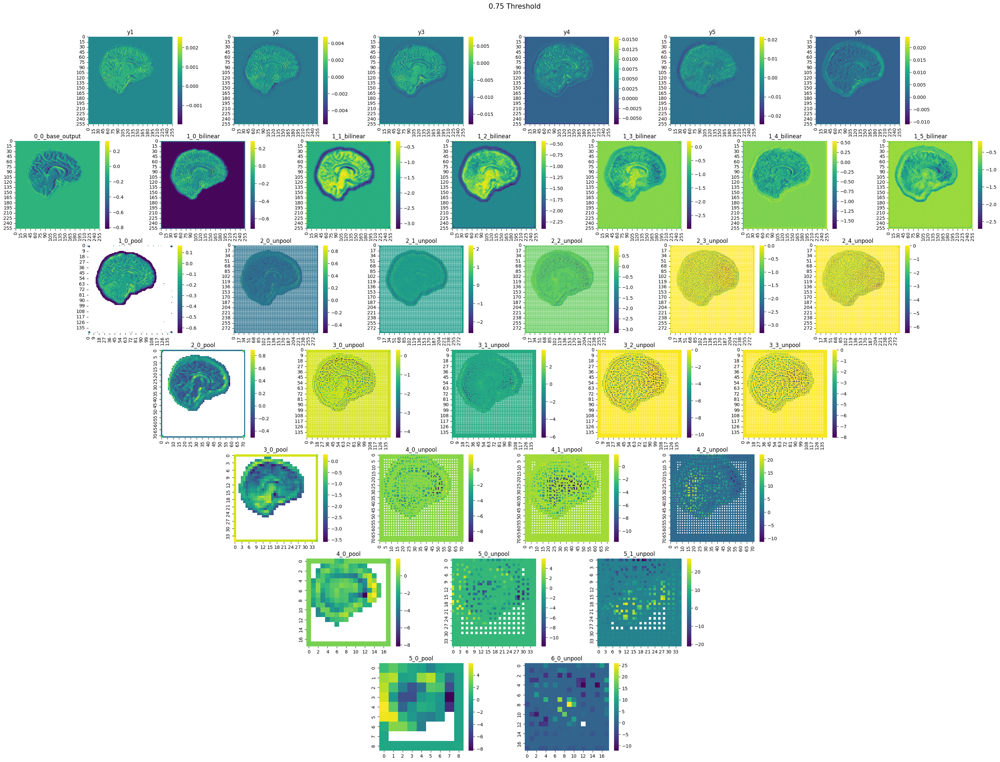

In [22]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh075/'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('0.75 Threshold', cmap, nan_root, 'axial', 10)


**Threshold 1 Epsilon 1e-5**

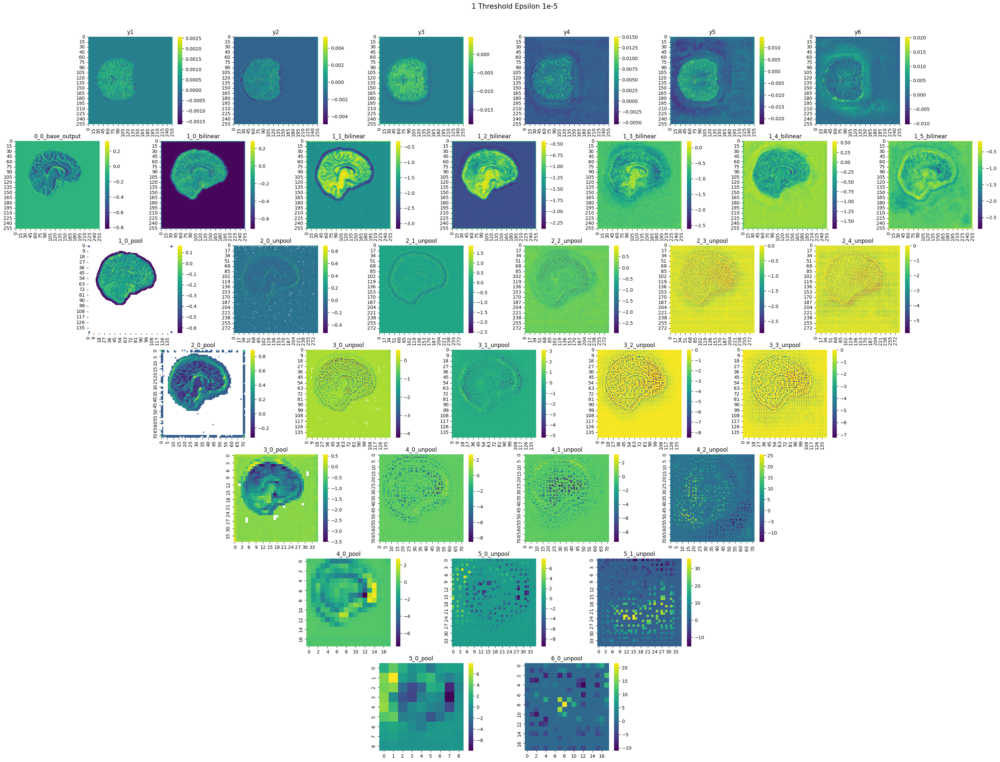

In [21]:
nan_root = '/scratch/vinuyans/skips/embeddings/thresh10/'
cmap = matplotlib.colormaps['viridis'] #.with_extremes(under='white', over='black')    
graph_arch('1 Threshold Epsilon 1e-5', cmap, nan_root, 'axial', 10)

### Visualizing why Threshold 1 has no NaNs for FONDUE

**VGG Block**
- Input x
- Parametric ReLU (Prelu)
    - ReLU forces all negative values to zero, while PReLU allows some negative values to pass through (with a small negative slope), providing more flexibility in learning patterns in the data.
- Performs conv on Prelu output; obtains x0
- Concatenates and takes the max out of original input and Prelu + conv output; obtains x1_max
- Performs Prelu and another conv on x1_max; obtains x1
- Concatenates and takes the max out of x1 and x1_max; obtains x2_max
- Performs conv on Prelu output; obtains out

**VGG Input Block**
- Input x
- Performs conv; obtains x0
- Performs Prelu + conv; obtains x1
- Concatenates and takes the max out of x0 and x1; obtains x2_max
- Performs Prelu + conv; obtains out


**Model**
- x0_0 = VGGBLockInput 0_0 --> 0_0_base_output
- x0_02 = Interpolation --> 0_0_bilinear
- x1_0 = VGGBlock 1_0 x0_02
- c_max = Concatenate + max out x0_0 and interpolated x1_0 
- x0_1 = VGGBlock 0_1 c_max --> 1_0_bilinear
- pool_x1_0 = Max pooling x1_0 --> 1_0_pool
- x2_0 = VGGBlock 2_0 pool_x1_0
- c2 = Unpool x2_0 --> 2_0_unpool
- c_max = Concatenate + max out x1_0 and c2 --> 1_1_max_input
- x1_1 = VGGBlock 1_1 c_max **DIAGRAMMED UP TO HERE**
- c_3 = interpolated x1_1 --> 1_1_bilinear
- c_max = Concatenate + max out x0_0, x0_1 and c_3
- x0_2 = VGGBlock 0_2 c_max 
- pool_x2_0 = Max pooling x2_0 --> 2_0_pool
- x3_0 = VGGBlock 3_0 pool_x2_0
- c2 = Unpool x3_0 --> 3_0_unpool
- c_max = Concatenate + max out x2_0 and c2 --> 2_1_max_input
- x2_1 = VGGBlock 2_1 c_max 
- c3 = Unpool x2_1 --> 2_1_unpool
- c_max = Concatenate + max out x1_0, x1_1 and c3 --> 1_2_max_input
- x1_2 = VGGBlock 1_2 c_max
- c4 = Interpolated x1_2 --> 1_2_bilinear
- c_max = Concatenate and max out x0_0, x0_1, x0_2 and c4
- x0_3 = VGGBlock 0_3 c_max
- pool_x3_0 = Max pooling x3_0 --> 3_0_pool
- x4_0 = VGGBlock 4_0 pool_x3_0
- c2 = Unpool x4_0 --> 4_0_unpool
- c_max = Concatenate + max out x3_0 and c2 --> 3_1_max_input
- x3_1 = VGGBlock 3_1 c_max
- c3 = Unpool x3_1 --> 3_1_unpool
- c_max = Concatenate + max out x2_0, x2_1 and c3 --> 2_2_max_input
- x2_2 = VGGBlock 2_2 c_max 
- c4 = Unpool x2_2 --> 2_2_unpool
- c_max = Concatenate + max out x1_0, x1_1, x1_2 and c4 --> 1_3_bilinear_max_input
- x1_3 = VGGBlock 1_3 c_max
- c5 = Interpolate x1_3 --> 1_3_bilinear
- c_max = Concatenate + max out x0_0, x0_1, x0_2, x0_3 and c5 --> 1_3_bilinear_max_output
- x0_4 = VGGBlock 0_4 c_max
- pool_x4_0 = Max pooling x4_0 --> 4_0_pool
- x5_0 = VGGBlock 5_0 pool_x4_0
- c2 = Unpool x5_0 --> 5_0_unpool
- c_max = Concatenate + max out x4_0 and c2 
- x4_1 = VGG Block 4_1 c_max
- c3 = Unpool x4_1 --> 4_1_unpool
- c_max = Concatenate + max out x3_0, x3_1 and c3 
- x3_2 = VGGBlock 3_2 c_max 
- c4 = Unpool x3_2 --> 3_2_unpool
- c_max = Concatenate + max out x2_0, x2_1, x2_2 and c4
- x2_3 = VGGBlock 2_3 c_max
- c5 = Unpool x2_3 --> 2_3_unpool
- c_max = Concatenate + max out x1_0, x1_1, x1_2, x1_3 and c5
- x1_4 = VGGBlock 1_4 c_max
- c6 = Interpolate x1_4 --> 1_4_bilinear
- c_max = Concatenate + max out x0_0, x0_1, x0_2, x0_3, x0_4 and c6
- x0_5 = VGGBlock 0_5 c_max
- pool_x5_0 = Max pooling x5_0 --> 5_0_pool
- x6_0 = VGGBlock 6_0 pool_x5_0
- c2 = Unpool x6_0 --> 6_0_unpool
- c_max = Concatenate + max out x5_0 and c2
- x5_1 = VGGBlock 5_1 c_max
- c3 = Unpool x5_1 --> 5_1_unpool
- c_max = Concatenate + max out x4_0, x4_1 and c3
- x4_2 = VGGBlock 4_2 c_max
- c4 = Unpool x4_2
- c_max = Concatenate + max out x3_0, x3_1, x3_2 and c4
- x3_3 = VGGBlock 3_3 c_max
- c5 = Unpool x3_3 --> 3_3_unpool
- c_max = Concatenate + max out x2_0, x2_1, x2_2, x2_3 and c5
- x2_4 = VGGBlock 2_4 c_max
- c6 = Unpool x2_4 --> 2_4_unpool
- c_max = Concatenate + max out x1_0, x1_1, x1_2, x1_3, x1_4 and c6
- x1_5 = VGGBlock 1_5 c_max
- c7 = Interpolate x1_5 --> 1_5_bilinear
- c_max = Concatenate + max out x0_0, x0_1, x0_2, x0_3, x0_4, x0_5 and c7
- x0_6 = VGGBlock 0_6 c_max
- output1 = ( conv x0_1 ) * alpha --> y1
- output2 = ( conv x0_2 ) * alpha --> y2
- output3 = ( conv x0_3 ) * alpha --> y3
- output4 = ( conv x0_4 ) * alpha --> y4
- output5 = ( conv x0_5 ) * alpha --> y5
- output6 = ( conv x0_6 ) * alpha --> y6
- output = (output1 + output2 + output3 + output4 + output5 + output6) / alpha_sum
- denoised = input - output --> denoised

torch.Size([2, 64, 288, 288])
torch.Size([2, 64, 144, 144])
torch.Size([2, 64, 144, 144])


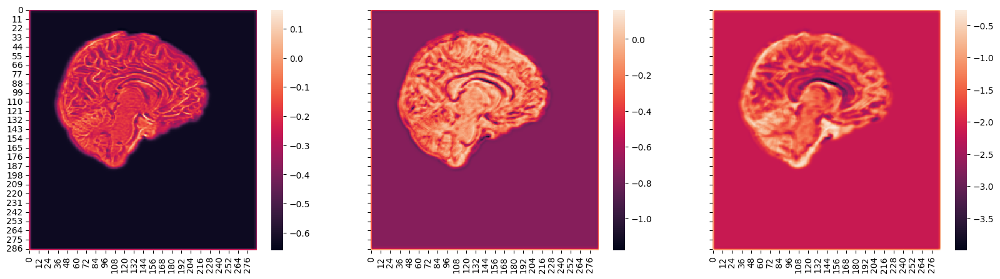

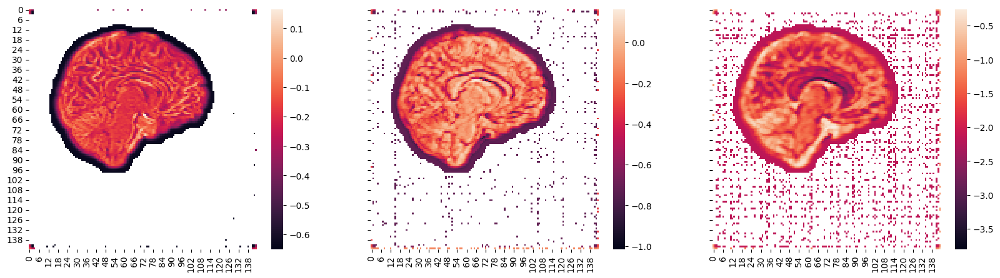

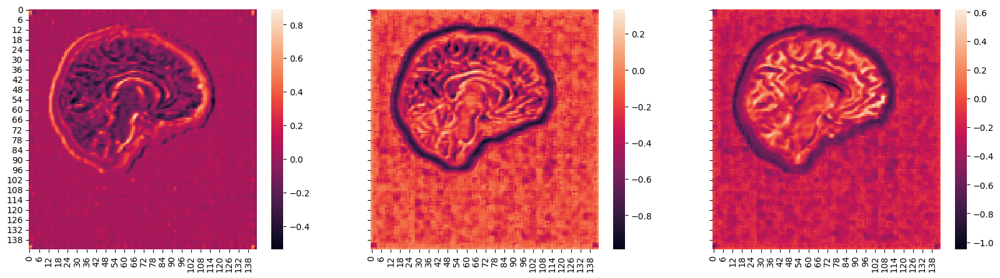

In [96]:
pool_1_0_input = pickle.load(open("/scratch/vinuyans/skips/embeddings/thresh10/axial_1_0_pool_input.pkl", "rb"))
print(pool_1_0_input.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(pool_1_0_input[0,10], ax=axes[0])
sns.heatmap(pool_1_0_input[0,30], ax=axes[1])
sns.heatmap(pool_1_0_input[0,50], ax=axes[2])

embed_1_0_bilinear = pickle.load(open("/scratch/vinuyans/skips/embeddings/thresh10/axial_1_0_pool.pkl", "rb"))
print(embed_1_0_bilinear.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(embed_1_0_bilinear[0,10], ax=axes[0])
sns.heatmap(embed_1_0_bilinear[0,30], ax=axes[1])
sns.heatmap(embed_1_0_bilinear[0,50], ax=axes[2])


embed_1_0_bilinear = pickle.load(open("/scratch/vinuyans/skips/embeddings/thresh10/axial_2_0_pool.pkl", "rb"))
print(embed_1_0_bilinear.shape)

fig, axes = plt.subplots(1, 3, figsize=(20,5), sharey=True)
sns.heatmap(embed_1_0_bilinear[0,10], ax=axes[0])
sns.heatmap(embed_1_0_bilinear[0,30], ax=axes[1])
sns.heatmap(embed_1_0_bilinear[0,50], ax=axes[2]);

## SkipConv

In [3]:
def count_skipped_ops(filename, thresh, slice, subjects):

    sub_count = []
    for subject in subjects:
        # "/scratch/vinuyans/skips/slurm/t1.0_sub-0003002_{i}.out"

        f = open(f"{filename}/t{thresh}_sub-{subject}_{slice}.out", 'r')
    #     print(filename)

        skip_count = {}

        for line in f: 
            
            line = line.strip()
            if 'model loaded' in line:
                if line.split('model loaded')[0].strip() == 'First':
                        axis = 'axial'
                        skip_count[axis] = {}
                elif line.split('model loaded')[0].strip() == 'Second':
                    axis = 'coronal'
                    skip_count[axis] = {}
                elif line.split('model loaded')[0].strip() == 'Third':
                    axis = 'sagittal'
                    skip_count[axis] = {}    
            # views = {'First': 'axial', 'Second': 'coronal', 'Third': 'sagittal'}
            
            # Regex pattern
            pattern = r'(?:\d{1,2} \w{3}  \d{1,2} \d{2}:\d{2}:\d{2} \d{4}, )?(\d+_\d+): Conv1: (\d+)/(\d+), Conv2: (\d+)/(\d+), Conv3: (\d+)/(\d+)'
            
            match = re.search(pattern, line)
            if match:
                key = match.group(1)
                # if key == '6_0': print('here')
                skip_count[axis][key] = {
                    'Conv1': int(match.group(2))/int(match.group(3)),
                    'Conv2': int(match.group(4))/int(match.group(5)),
                    'Conv3': int(match.group(6))/int(match.group(7))
                }
        
        sub_count.append( skip_count )
     
    return sub_count


block_order = ['0_0', '1_0', '2_0', '3_0', '4_0', '5_0', '6_0',
               '0_1', '1_1', '2_1', '3_1', '4_1', '5_1',
               '0_2', '1_2', '2_2', '3_2', '4_2',
               '0_3', '1_3', '2_3', '3_3',
               '0_4', '1_4', '2_4',
               '0_5', '1_5',
               '0_6']

# block_order = ['0_0',
#                '0_1', '1_0',
#                '0_2', '1_1', '2_0',
#                '0_3', '1_2', '2_1', '3_0',
#                '0_4', '1_3', '2_2', '3_1', '4_0',
#                '0_5', '1_4', '2_3', '3_2', '4_1', '5_0',
#                '0_6', '1_5', '2_4', '3_3', '4_2', '5_1', '6_0']


def aggregate_per_threshold(thresh, thresh_sub):

    sub_ratio = {thresh: {'coronal': {}, 'axial': {}, 'sagittal': {}} }

    for num, slice in enumerate(thresh_sub):
        # Each `slice` represents a list of subjects for the current `num` (block)

        for subject_idx, subject in enumerate(slice):

            for plane in subject:
                if num not in sub_ratio[thresh][plane]:
                    # Initialize as a 2D list, where each row represents a subject
                    sub_ratio[thresh][plane][num] = []

                subject_values = []
                for block in block_order:
                    # Append the mean value for the current subject and plane
                    subject_values.append(np.mean(list(subject[plane][block].values())))

                # Now add these subject values as a new row (horizontally)
                sub_ratio[thresh][plane][num].append(subject_values)

        # Convert list to numpy array for consistent (subjects, blocks) shape
        for plane in sub_ratio[thresh]:
            for num in sub_ratio[thresh][plane]:
                sub_ratio[thresh][plane][num] = np.array(sub_ratio[thresh][plane][num])

    return sub_ratio



# _ = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t1_{5}.out")


### Experimenting Across Epsilons

#### Raw Images

**Threshold 0.3**

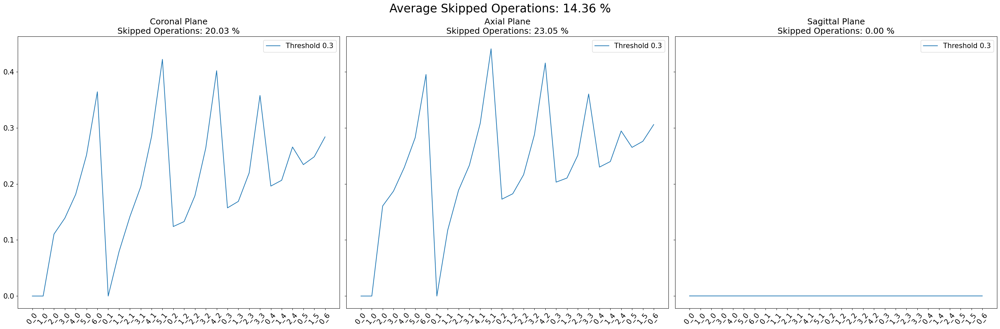

In [41]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.3_sub-0003002_ses-1_run-1_T1w.nii.gz_60.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.3', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.3']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.3'][plane].values()) for plane in sub_ratio['0.3'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.4 Epsilon 1e-7**

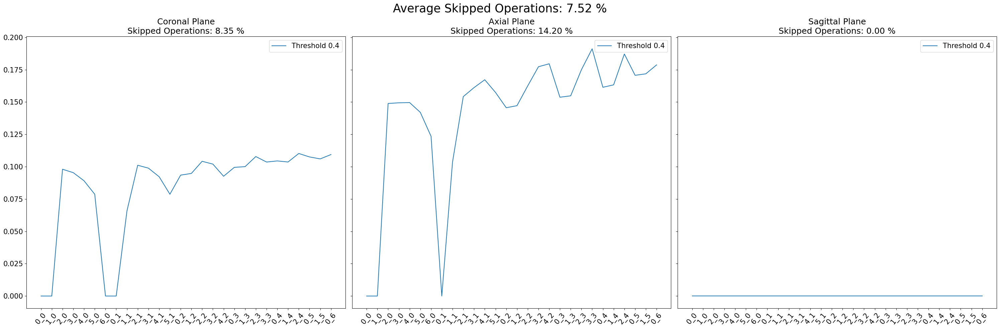

In [7]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.4_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-7.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.4', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.4']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.4'][plane].values()) for plane in sub_ratio['0.4'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.4 Epsilon 1e-6**

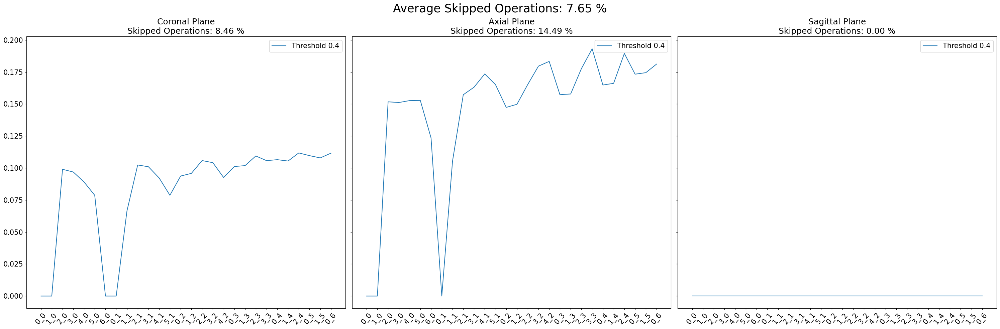

In [4]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.4_sub-0003002_ses-1_run-1_T1w.nii.gz_60.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.4', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.4']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.4'][plane].values()) for plane in sub_ratio['0.4'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.4 Epsilon 1e-5**

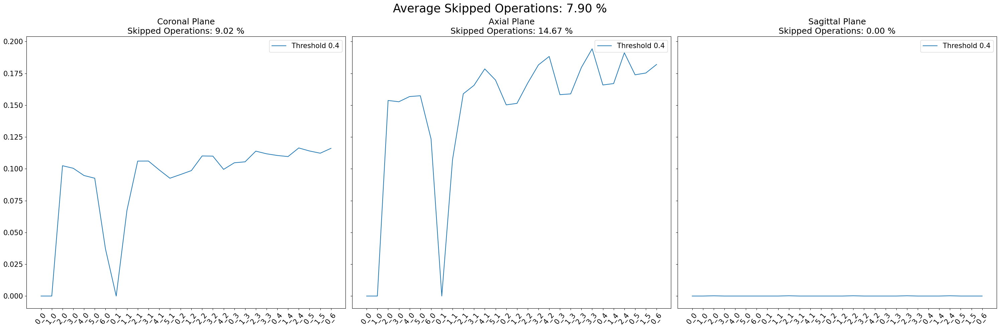

In [4]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.4_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-5.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.4', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.4']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.4'][plane].values()) for plane in sub_ratio['0.4'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.5 Epsilon 1e-7**

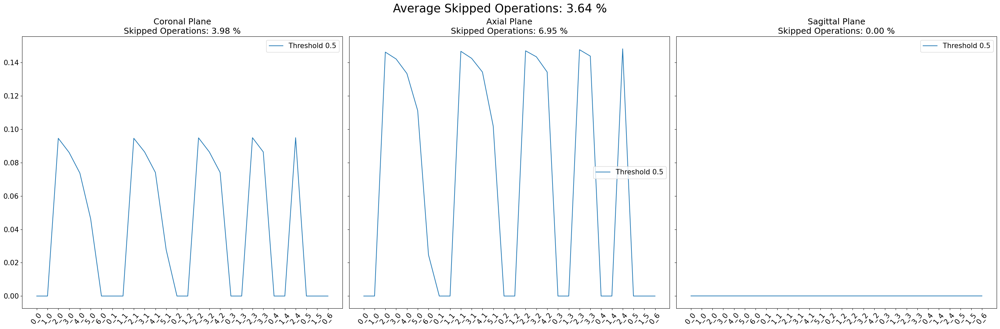

In [ ]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.5_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-7.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.5', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.5'][plane].values()) for plane in sub_ratio['0.5'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.5 Epsilon 1e-6**

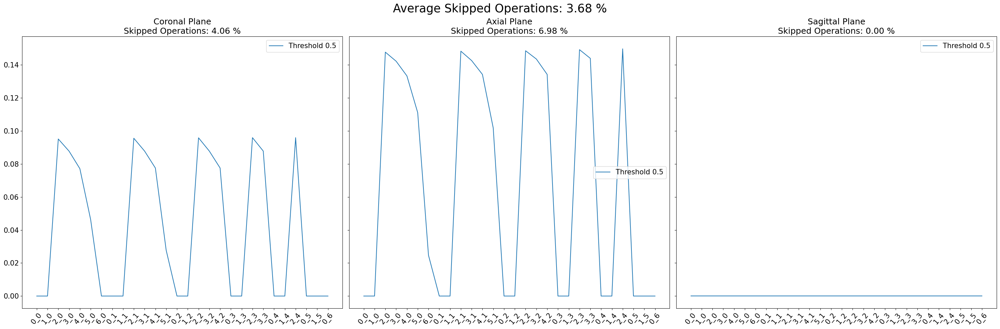

In [5]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.5_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-6.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.5', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.5'][plane].values()) for plane in sub_ratio['0.5'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.5 Epsilon 1e-5**

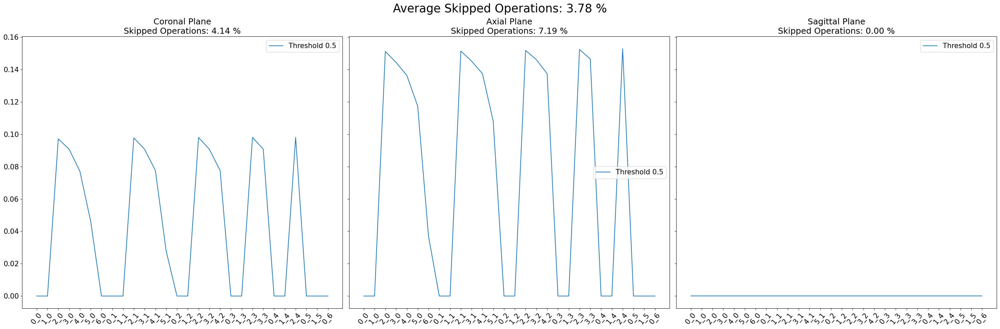

In [5]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.5_sub-0003002_ses-1_run-1_T1w.nii.gz_60_eps1e-5.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.5', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.5'][plane].values()) for plane in sub_ratio['0.5'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 0.75**

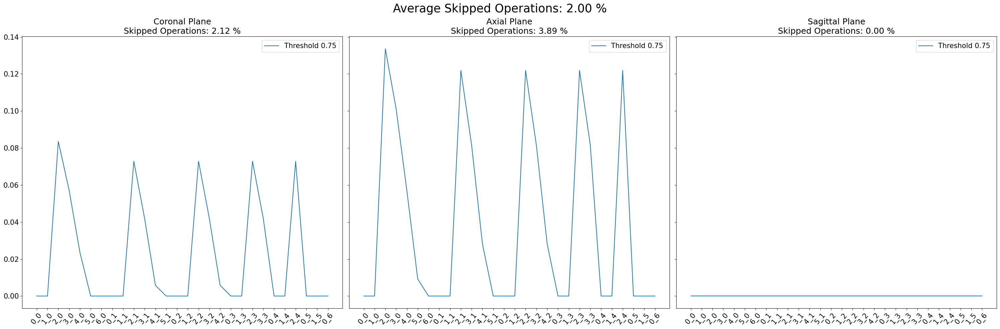

In [42]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.75_sub-0003002_ses-1_run-1_T1w.nii.gz_60.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.75', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.75']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.75'][plane].values()) for plane in sub_ratio['0.75'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


#### Processed

**Threshold 0.75 Epsilon=1e-7**

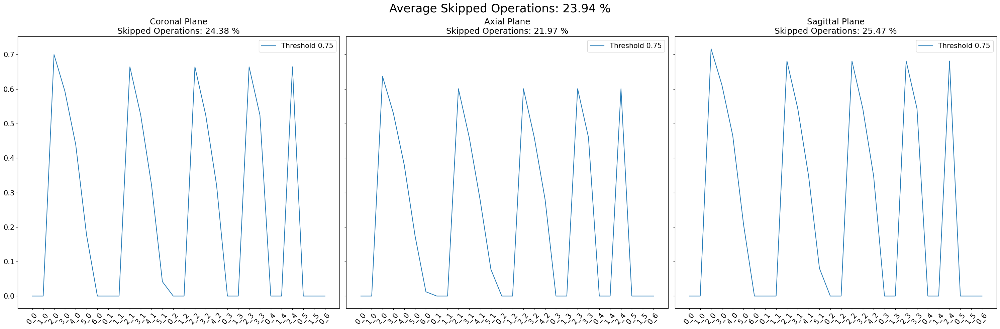

In [44]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.75_sub-0003002_embedding.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.75', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['0.75']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['0.75'][plane].values()) for plane in sub_ratio['0.75'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 1 Epsilon=1e-6**

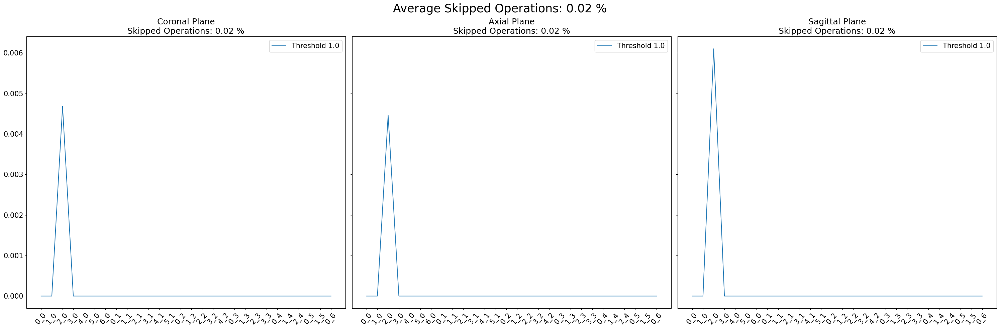

In [47]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t1.0_sub-0003002_60_ep1e-6.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('1.0', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['1.0']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['1.0'][plane].values()) for plane in sub_ratio['1.0'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


**Threshold 1.0 Epsilon=1e-5**

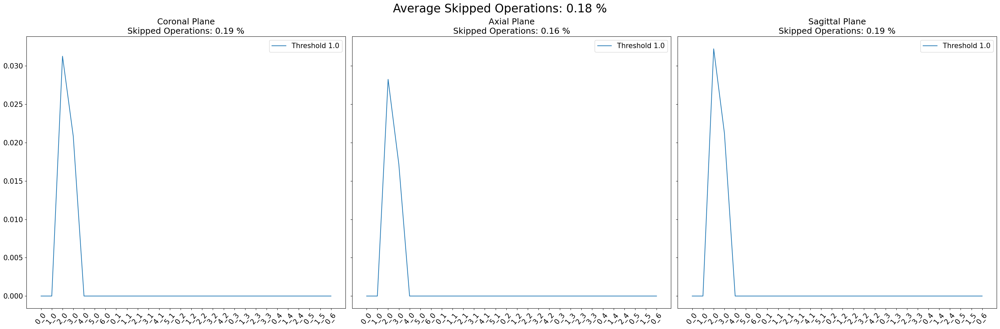

In [48]:
thresh075_sub = count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t1.0_sub-0003002_60_ep1e-5.out")

sub_ratio={}


# sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('1.0', [thresh075_sub]))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['1.0']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=0)
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=0)

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane\nSkipped Operations: {np.mean( np.array(list(sub_ratio[thresh][plane].values())) )*100:.2f} %', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.suptitle(f"Average Skipped Operations: {np.array([list(sub_ratio['1.0'][plane].values()) for plane in sub_ratio['1.0'].keys()]).mean()*100:.2f} %", fontsize=25)
plt.tight_layout()


### Final Visualizations

In [5]:
thresh1_sub = [count_skipped_ops(filename=f"/scratch/vinuyans/skips/slurm", thresh='1.0', slice=i, subjects=['0003002', '0025011', '0025248', '0025350', '0025531'] ) for i in range(128) ]
# thresh075_sub = [count_skipped_ops(f"/scratch/vinuyans/skips/slurm/t0.75_sub-0003002_{i}.out") for i in range(128)]
thresh075_sub = [count_skipped_ops(filename=f"/scratch/vinuyans/skips/slurm", thresh='0.75', slice=i, subjects=['0003002', '0025011', '0025248', '0025350', '0025531'] ) for i in range(128)]
thresh05_sub = [count_skipped_ops(filename=f"/scratch/vinuyans/skips/slurm", thresh='0.5', slice=i, subjects=['0003002', '0025011', '0025248', '0025350', '0025531'] ) for i in range(128)]

**Visualize Across Architectural Blocks**

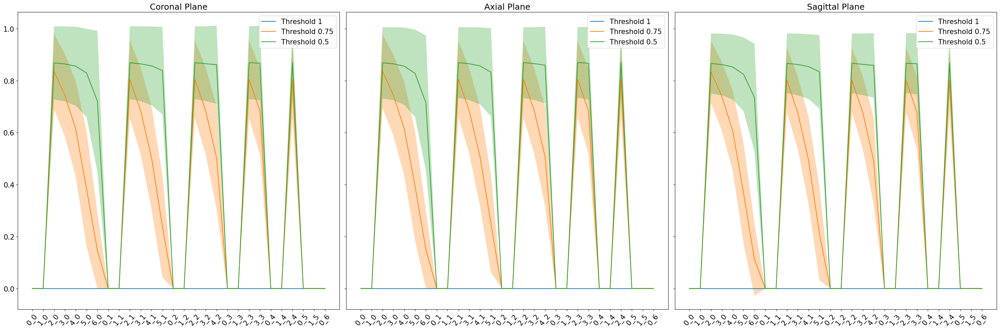

In [7]:
# sub_ratio = {'1': {'coronal': {}, 'axial': {}, 'sagittal': {}}, '0.5': {'coronal': {}, 'axial': {}, 'sagittal': {}} }
sub_ratio = {}

sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.75', thresh075_sub))
sub_ratio.update(aggregate_per_threshold('0.5', thresh05_sub))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
# for num, plane in enumerate(['axial']):

    for thresh in ['1', '0.75','0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=(0,1))
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=(0,1))

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].set_xticks(np.arange(len(avg)), block_order, rotation=50, fontsize=13)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)

plt.tight_layout()


**Visualize Across Brain Slices**

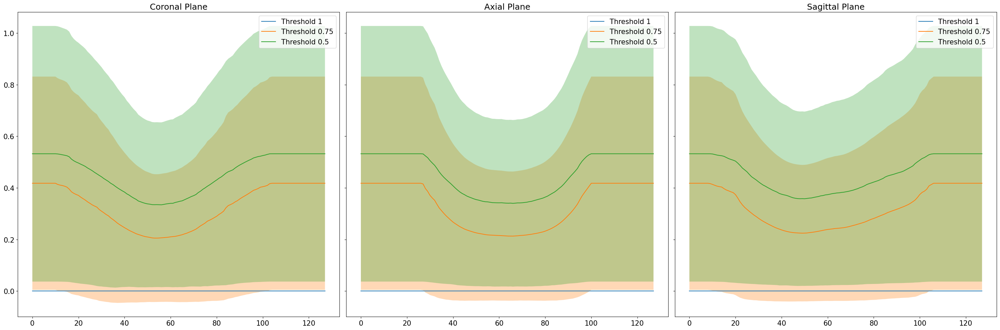

In [8]:
sub_ratio = {}

sub_ratio.update(aggregate_per_threshold('1', thresh1_sub))
sub_ratio.update(aggregate_per_threshold('0.75', thresh075_sub))
sub_ratio.update(aggregate_per_threshold('0.5', thresh05_sub))


fig, axes = plt.subplots(1, 3, figsize=(30,10), sharey=True)

for num, plane in enumerate(['coronal', 'axial', 'sagittal']):

    for thresh in ['1', '0.75','0.5']:

        subs = np.array(list(sub_ratio[thresh][plane].values()))

        avg = np.mean( np.array(list(sub_ratio[thresh][plane].values())), axis=(1,2))
        stdev = np.std( np.array(list(sub_ratio[thresh][plane].values())), axis=(1,2))

        axes[num].plot(avg, label=f'Threshold {thresh}')
        axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
        # axes[num].set_ylim(-0.1,1)
        axes[num].set_title(f'{plane.title()} Plane', fontsize=18)
        axes[num].legend(fontsize=15)
        axes[num].tick_params(axis='x', labelsize=15)  
        axes[num].tick_params(axis='y', labelsize=15)  

plt.tight_layout()


## SNR

### Peak SNR

* In order to calculate SNR we need to aggregate the slices
```
apptainer shell --bind /scratch/ine5/fs_subject_ieee/:/data --bind /scratch/vinuyans/skips/:/skips --bind /scratch/vinuyans/fondue:/FONDUE/ fondue_ieee.sif
python /FONDUE/aggregate.py --in_name /data/sub-0003002/norm.nii.gz --out_name /skips/sub-0003002/thresh05/sub-0003002_thresh05_aggr.nii.gz --no_cuda --sub_root /skips/sub-0003002/thresh05

```

**Calculation of peak SNR** 

* Calculate PSNR across raw slices + aggregated final FONDUE output
* For aggregated output we need to normalize the denoised images in order to match how FONDUE authors calculated PSNR + we use their method of loading images (minor differences in calculated PSNR due to this)

In [51]:
# Modified MSE function for masked arrays
def mse(original, reconstructed):
    masked_diff = np.ma.masked_array((original - reconstructed) ** 2)
    return masked_diff.mean()  # Calculate mean of masked array elements

class PSNR:
    """Peak Signal to Noise Ratio
    img1 and img2 have range [0, 255]"""

    def __init__(self):
        self.name = "PSNR"

    @staticmethod
    def __call__(img1, img2, device):
        # mse = torch.nn.MSELoss()
        # a = img1.to(device, dtype = torch.float32)
        # b = img2.to(device, dtype = torch.float32)
        # print(img1.compressed.shape, img2.compressed.shape)
        mse_total = mse(img1,img2)
        print(mse_total)
        psnr = 20 * np.log10(1.0 / np.ma.sqrt(mse_total))
        return psnr
    
def min_max_normalize(masked_array):
    # Calculate the min and max of the unmasked elements
    min_val = masked_array.min()
    max_val = masked_array.max()

    # Apply min-max normalization only to unmasked elements
    normalized_array = (masked_array - min_val) / (max_val - min_val)
    
    return normalized_array



In [29]:
class PSNR:
    """Peak Signal to Noise Ratio
    img1 and img2 have range [0, 255]"""

    def __init__(self):
        self.name = "PSNR"

    @staticmethod
    def __call__(img1, img2, device):
        mse = torch.nn.MSELoss()
        a = img1.to(device, dtype = torch.float32)
        b = img2.to(device, dtype = torch.float32)
        mse_total = mse(a,b)
        psnr = 20 * torch.log10(1.0 / torch.sqrt(mse_total))
        return psnr
    
# Modified MSE function for masked arrays
def mse(original, reconstructed):
    masked_diff = np.ma.masked_array((original - reconstructed) ** 2)
    return masked_diff.mean()  # Calculate mean of masked array elements

class PSNR2:
    """Peak Signal to Noise Ratio
    img1 and img2 have range [0, 255]"""

    def __init__(self):
        self.name = "PSNR"

    @staticmethod
    def __call__(img1, img2, device):
        # mse = torch.nn.MSELoss()
        # a = img1.to(device, dtype = torch.float32)
        # b = img2.to(device, dtype = torch.float32)
        # print(img1.compressed.shape, img2.compressed.shape)
        mse_total = mse(img1,img2)
        psnr = 20 * np.log10(1.0 / np.ma.sqrt(mse_total))
        return psnr
    
def min_max_normalize(masked_array):
    # Calculate the min and max of the unmasked elements
    min_val = masked_array.min()
    max_val = masked_array.max()

    # Apply min-max normalization only to unmasked elements
    normalized_array = (masked_array - min_val) / (max_val - min_val)
    
    return normalized_array

def calculate_psnr(img1, img2):
    # Ensure the images have the same shape
    assert img1.shape == img2.shape, "Input images must have the same dimensions"
    
    # Calculate MSE
    mse = np.mean((img1 - img2) ** 2)
    
    # Avoid division by zero
    if mse == 0:
        return float('inf'), None  # Identical images would have infinite PSNR

    # Calculate the maximum intensity of the original image
    max_intensity = np.max(img1)
    print(max_intensity)

    # Calculate PSNR
    psnr = 10 * np.log10((max_intensity ** 2) / mse)
    return psnr

def normalize(slice):
    min_val = slice.min()
    max_val = slice.max()

    # Check if max equals min to avoid division by zero
    if max_val != min_val:
        slice = (slice - min_val) / (max_val - min_val)
    else:
        # All values are the same, assign a constant value, e.g., 0
        slice = torch.zeros_like(slice)

    return slice

def getvol(path_denoised):
    img_denoised = load_and_conform_image(path_denoised) #Read the image
    img_denoised = np.nan_to_num(img_denoised)
    # print(img_denoised.min(), img_denoised.max())
    img_denoised = 255.0*(img_denoised - img_denoised.min()) / \
        (img_denoised.max() - img_denoised.min())
    img_denoised = img_denoised.astype(np.single)
    return img_denoised

def smooth_and_binarize_mask(volume, sigma=1.0, threshold=0.1, dilation_iterations=1):
    """
    Smooth a 3D array, threshold non-zero values, and binarize the result.

    Parameters:
    - volume: 3D NumPy array to process
    - sigma: float, standard deviation for Gaussian kernel (default=1.0)
    - threshold: float, threshold value for binarization (default=0.1)
    
    Returns:
    - binary_mask: 3D binary mask as a NumPy array
    """

    # Step 1: Apply Gaussian smoothing to the input volume
    smoothed_volume = gaussian_filter(volume, sigma=sigma)
    
    # Step 2: Threshold values that are not zero
    thresholded_volume = np.where(smoothed_volume > threshold, 1, 0)
    
    # Step 3: Return the binary mask
    binary_mask = (thresholded_volume > 0).astype(np.uint8)
    
    # Step 4: Apply binary dilation to close any holes
    dilated_mask = binary_dilation(binary_mask, iterations=dilation_iterations).astype(np.uint8)
    
    return dilated_mask

def peak_snr_across_slices_aggregated(filedir, thresholds, subjects, raw):
    
    fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=True)
    psnr = PSNR2()
    snr = {}

    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
        snr[plane] = {}

        for thresh in thresholds:
            snr_slices_per_subject = []

            for subject in subjects:
                subject_snr_slices = []
                # subject_dir = f'{filedir}/{subject}'
                mask = smooth_and_binarize_mask(nib.load(f'{filedir}/sub-{subject}/groundtruth.nii').get_fdata(), sigma=0.5, threshold=0.)

                ieee_img = getvol(f'{filedir}/sub-{subject}/groundtruth.nii')
                if thresh == 'ieee':
                    # thresh_img = getvol(f'{filedir}/ieee/sub-{subject}/sub-{subject}_ieee_whole.nii.gz')
                    thresh_img = getvol(f'{filedir}/sub-{subject}/ieee/sub-{subject}_ieee_aggr{raw}.nii.gz')
                else:
                    if (subject == '0025011' and thresh == '05') or (subject == '0025248' and thresh == '05'):
                        thresh_img = getvol(f'{filedir}/sub-{subject}/thresh{thresh}_cp/sub-{subject}_thresh{thresh}_aggr.nii.gz')
                    else:
                        thresh_img = getvol(f'{filedir}/sub-{subject}/thresh{thresh}/sub-{subject}_thresh{thresh}_aggr.nii.gz')

                for i in range(256):
                    if plane == 'axial':
                        ieee_slice = ieee_img[i]
                        thresh_slice = thresh_img[i]
                        mask_slice = mask[i]
                    elif plane == 'sagittal':
                        ieee_slice = ieee_img[:, :, i]
                        thresh_slice = thresh_img[:, :, i]
                        mask_slice = mask[:, :, i]
                    else:
                        ieee_slice = ieee_img[:, i, :]
                        thresh_slice = thresh_img[:, i, :]
                        mask_slice = mask[:, i, :]

                    # ieee_slice = torch.from_numpy(ieee_slice).to('cpu').type(torch.float16) 
                    # thresh_slice = torch.from_numpy(thresh_slice).to('cpu').type(torch.float16) 

                    # ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())
                    # thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())

                    ieee_slice = np.ma.masked_array(ieee_slice, mask=~mask_slice.astype(bool))
                    thresh_slice = np.ma.masked_array(thresh_slice, mask=~mask_slice.astype(bool))

                    ieee_slice = min_max_normalize(ieee_slice )
                    thresh_slice = min_max_normalize(thresh_slice )


                    output = psnr(ieee_slice, thresh_slice, 'cpu').item()
                    # output = psnr(ieee_slice[mask_slice != False], thresh_slice[mask_slice != False], 'cpu').item()
                    subject_snr_slices.append(output)


                snr_slices_per_subject.append(subject_snr_slices)

            # Aggregate SNR per threshold across subjects
            snr[plane][thresh] = snr_slices_per_subject

            # Plotting (assuming averaging across subjects for plotting)
            # avg_snr_slices = np.mean(snr_slices_per_subject, axis=0)
            avg = np.mean( np.array(snr[plane][thresh]), axis=(0))
            stdev = np.std( np.array(snr[plane][thresh]), axis=(0))

            label = 'Default' if thresh == 'ieee' else f'Threshold {thresh}'
            axes[num].plot(avg, label=label)
            axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)  

            axes[num].set_xlim(1, 256)
        
        axes[num].legend(fontsize=15)
        axes[num].set_title(plane.title(), fontsize=18)
    axes[0].set_ylabel('PSNR (dB)', fontsize=15)
    plt.tight_layout()

    return snr


def peak_snr_across_slices_unmerged(filedir):

    fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=True)
    psnr = PSNR()



    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
        
        for thresh in ['1', '05', '075']:
            snr_slices = []

            for i in range(128):

                ieee_slice = pickle.load(open(f"{filedir}/ieee/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()               
                thresh_slice = pickle.load(open(f"{filedir}/thresh{thresh}/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()                  
                    
                #Create MASK FROM IEEE

                # snr_slices.append(calculate_psnr(ieee_slice, thresh_slice))
                snr_slices.append(psnr(ieee_slice, thresh_slice, 'cpu'))

            if thresh == 'ieee': 
                axes[num].plot(snr_slices, label=f'Default')            
            else:
                axes[num].plot(snr_slices, label=f'Threshold {thresh}')
        axes[num].legend()
        axes[num].set_title(plane.title())
    axes[0].set_ylabel('PSNR (dB)')
    plt.tight_layout()


In [ ]:
snr_mask = peak_snr_across_slices_aggregated("/scratch/vinuyans/skips", thresholds=['1','075', '05', '04', 'ieee'], subjects=['0003002', '0025011', '0025248', '0025350', '0025531'], raw="" )


/tmp/ipykernel_949167/1370835665.py:24: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


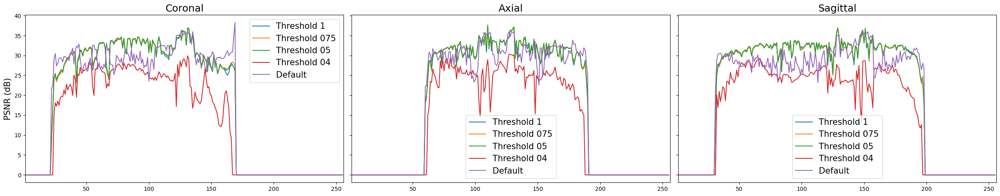

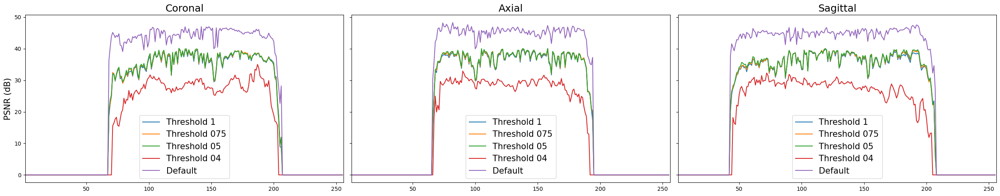

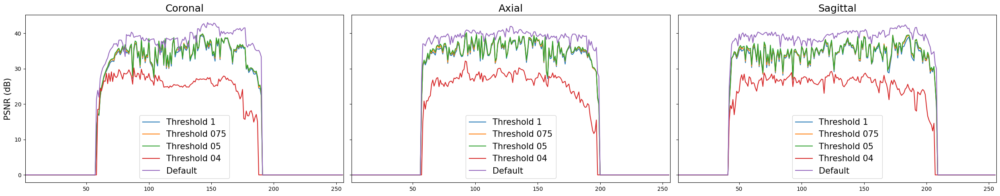

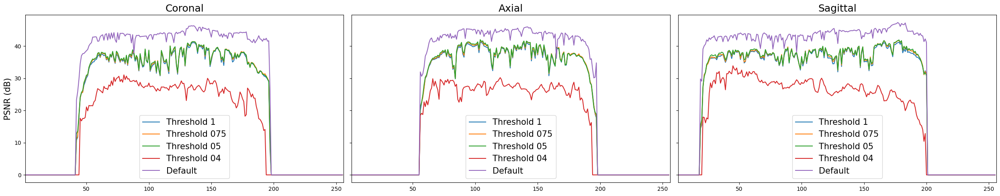

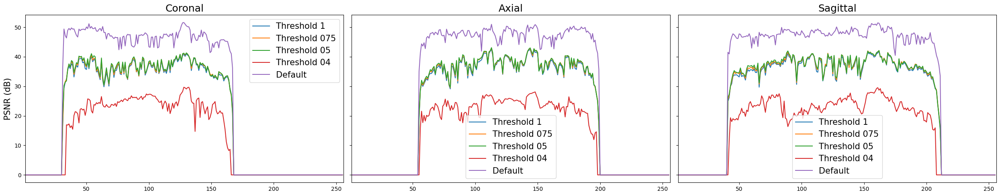

In [11]:
for sub in range(5):
    fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=True)

    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):

        for thresh in ['1','075', '05', '04', 'ieee']:

            # for subject in ['0003002']:
            # avg = np.mean( np.array(snr[plane][thresh]), axis=(0))
            # stdev = np.std( np.array(snr[plane][thresh]), axis=(0))

            label = 'Default' if thresh == 'ieee' else f'Threshold {thresh}'

            axes[num].plot(np.array(snr_mask[plane][thresh][sub]), label=label)
            # axes[num].plot(avg, label=label)
            # axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)  

            axes[num].set_xlim(1, 256)
            # break
            
        axes[num].legend(fontsize=15)
        axes[num].set_title(plane.title(), fontsize=18)
        axes[0].set_ylabel('PSNR (dB)', fontsize=15)
        plt.tight_layout()
        # break


/tmp/ipykernel_949167/3086470198.py:36: RuntimeWarning: divide by zero encountered in log10
  psnr = 20 * np.log10(1.0 / np.ma.sqrt(mse_total))


Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS ori

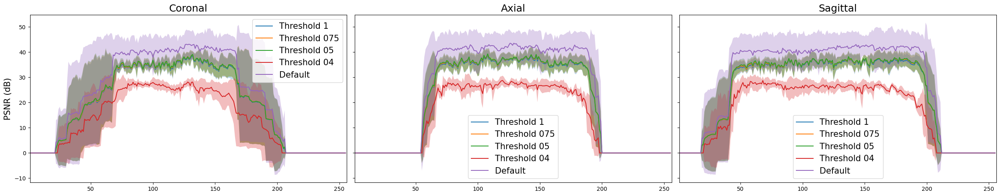

In [9]:
snr_mask = peak_snr_across_slices_aggregated("/scratch/vinuyans/skips", thresholds=['1','075', '05', '04', 'ieee'], subjects=['0003002', '0025011', '0025248', '0025350', '0025531'], raw="" ) 
pickle.dump(snr_mask, open('fondue_psnr_mask.pkl', 'wb'))

(4, 1280)
(4, 1280)
(4, 1280)


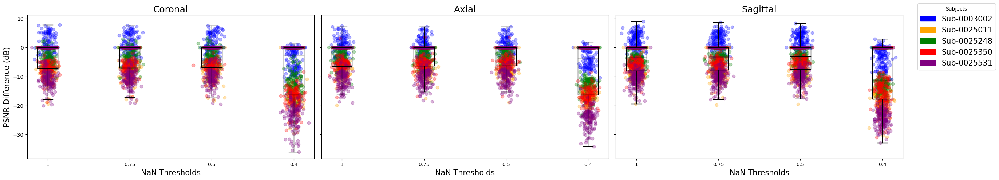

In [6]:
PROPS = {
    'boxprops': {'facecolor': 'none', 'edgecolor': 'black'},
    'medianprops': {'color': 'black'},
    'whiskerprops': {'color': 'black'},
    'capprops': {'color': 'black'}
}

# Load the SNR data
snr = pickle.load(open('/scratch/vinuyans/skips/fondue_psnr_mask.pkl', 'rb'))

# Set up the plot with 3 subplots, one for each plane
fig, axes = plt.subplots(1, 3, figsize=(25, 5), sharey=True)

# Define subject colors
subject_colors = ['blue', 'orange', 'green', 'red', 'purple']  # Colors for each subject
subject_ids = ['0003002', '0025011', '0025248', '0025350', '0025531']  # Subject IDs

# Iterate over the planes
for num, plane in enumerate(['coronal', 'axial', 'sagittal']):

    # Store aggregated data for each threshold across all subjects
    threshold_data = []

    # Loop through thresholds (excluding IEEE as it is the baseline)
    for thresh in ['1', '075', '05', '04']:
        
        # Calculate SNR difference between each threshold and IEEE per subject
        ieee_values = np.array(snr[plane]['ieee'])  # Shape: (5, 256)
        thresh_values = np.array(snr[plane][thresh])  # Shape: (5, 256)
        snr_diff = thresh_values - ieee_values  # Shape: (5, 256)

        # Flatten snr_diff for all subjects and add to threshold_data
        threshold_data.append(snr_diff.flatten())

    threshold_data = np.nan_to_num(threshold_data)

    # Plot a single boxplot per threshold (aggregating all subjects)
    bplot = axes[num].boxplot(
        threshold_data.T,  # Aggregated data for each threshold
        positions=[1, 3, 5, 7],  # Position each threshold boxplot separately
        widths=0.5, patch_artist=True, showfliers=False, **PROPS)


    # Overlay scatter points for individual subject data
    for i, data in enumerate(threshold_data):
        for sub_idx in range(len(subject_ids)):
            y = data[sub_idx * 256:(sub_idx + 1) * 256]  # Data for one subject
            x = np.random.normal(loc=(i * 2 + 1), scale=0.1, size=len(y))  # Jitter points
            axes[num].scatter(x, y, alpha=0.3, color=subject_colors[sub_idx])

    # Set plot limits, labels, and title
    axes[num].set_title(plane.title(), fontsize=18)
    axes[num].set_xticks([1, 3, 5, 7])  # Position for each threshold
    axes[num].set_xticklabels(['1', '0.75', '0.5', '0.4'])
    axes[num].set_xlabel('NaN Thresholds', fontsize=15)

# Create custom legend for subjects
legend_patches = [mpatches.Patch(color=color, label=f'Sub-{sub_id}') for color, sub_id in zip(subject_colors, subject_ids)]
fig.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.1, 1), title='Subjects', fontsize=15)

# Configure the y-axis label
axes[0].set_ylabel('PSNR Difference (dB)', fontsize=15)

plt.tight_layout()
plt.show()


## SSIM

**NEW SSIM Calculation -- extract only brain matter using mask**

In [45]:
def ssim_across_slices_scipy(filedir, thresholds, subjects, share=True):

    fig, axes = plt.subplots(1, 3, figsize=(25,5), sharey=share)

    ssim_dict = {}



    for num, plane in enumerate(['coronal', 'axial', 'sagittal']):
    # for num, plane in enumerate(['coronal']):
        ssim_dict[plane] = {}
        
        for thresh in thresholds:

            ssim_slices_per_subject = []

            for subject in subjects:        
        
                ssim_slices = []
                ssim_dict[plane][thresh] = []

                # mask_template = getvol('/scratch/vinuyans/skips/sub-0003002/sub-0003002_ieee_whole_mask.nii.gz')
                mask = smooth_and_binarize_mask(nib.load(f'{filedir}/sub-{subject}/groundtruth.nii').get_fdata(), sigma=0.5, threshold=0.) 
                # if masked:
                #     ieee_img = getvol('{filedir}/ieee/sub-{subject}/sub-{subject}_ieee_whole_mask.nii.gz')
                #     thresh_img = getvol(f'{filedir}/sub-{subject}/thresh{thresh}/sub-{subject}_thresh{thresh}_aggr_masked.nii.gz')
                # else:
                ieee_img = getvol(f'{filedir}/sub-{subject}/groundtruth.nii')
                if thresh == 'ieee':
                    # thresh_img = getvol(f'/scratch/vinuyans/skips/ieee/sub-0003002/sub-0003002_ieee_whole.nii.gz')
                    thresh_img = getvol(f'{filedir}/sub-{subject}/ieee/sub-{subject}_ieee_aggr.nii.gz')

                else:
                    thresh_img = getvol(f'{filedir}/sub-{subject}/thresh{thresh}/sub-{subject}_thresh{thresh}_aggr.nii.gz')

                #get mask
                # mask = np.where(mask_template == 0, False, True).squeeze()


                for i in range(100,130):

                    # ieee_slice = pickle.load(open(f"{filedir}/ieee/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()      
                    # thresh_slice = pickle.load(open(f"{filedir}/thresh{thresh}/{plane}/processed/{i}_slice.pkl", "rb")) #.squeeze()[0].numpy()                  
                    if plane == 'axial':
                        ieee_slice = ieee_img[i]
                        thresh_slice = thresh_img[i]
                        mask_slice = mask[i]
                    elif plane == 'sagittal':
                        ieee_slice = ieee_img[:, :, i]
                        thresh_slice = thresh_img[:, :, i]
                        mask_slice = mask[:, :, i]
                    else:
                        ieee_slice = ieee_img[:, i, :]
                        thresh_slice = thresh_img[:, i, :]
                        mask_slice = mask[:, i, :]

                    # ieee_slice = torch.from_numpy(ieee_slice).to('cpu').type(torch.float16) 
                    # thresh_slice = torch.from_numpy(thresh_slice).to('cpu').type(torch.float16) 

                    # ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())
                    # thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())

                    # ieee_slice = torch.unsqueeze(ieee_slice, 0)
                    # thresh_slice = torch.unsqueeze(thresh_slice, 0)

                    ieee_slice = np.ma.masked_array(ieee_slice, mask=~mask_slice.astype(bool))
                    thresh_slice = np.ma.masked_array(thresh_slice, mask=~mask_slice.astype(bool))

                    # ieee_slice = min_max_normalize(ieee_slice )
                    # thresh_slice = min_max_normalize(thresh_slice )


                    try:
                        ssim_noise = ssim(ieee_slice, thresh_slice, data_range=1)
                        # ssim_noise = ssim(ieee_slice[mask_slice != False], thresh_slice[mask_slice != False], data_range=1)
                    except:
                        ssim_noise = float('nan')

                    ssim_slices.append( ssim_noise )
                
                ssim_slices_per_subject.append(ssim_slices)

            ssim_dict[plane][thresh] = ssim_slices_per_subject

            # axes[num].plot(np.nan_to_num(ssim_slices), label=f'Threshold {thresh}')
            avg = np.mean( np.array(ssim_dict[plane][thresh]), axis=(0))
            stdev = np.std( np.array(ssim_dict[plane][thresh]), axis=(0))

            if thresh == 'ieee':
                axes[num].plot(avg, label=f'Default')            
            else:
                axes[num].plot(avg, label=f'Threshold {thresh}')
            axes[num].fill_between(range(len(avg)), avg - stdev, avg + stdev, alpha=0.3)
            # break
        axes[num].legend()
        # axes[num].set_xlim(1, 256)

        axes[num].set_title(plane.title(), fontsize=18)
        # break
    axes[0].set_ylabel('SSIM', fontsize=15)
    axes[0].set_ylabel('Brain Slices', fontsize=15)
    # axes[0].set_ylim(0, 1.05)
    plt.tight_layout()

    return ssim_dict


/tmp/ipykernel_3990701/2662298312.py:62: RuntimeWarning: invalid value encountered in divide
  ieee_slice = (ieee_slice - ieee_slice.min()) / (ieee_slice.max() - ieee_slice.min())


Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels



/tmp/ipykernel_3990701/2662298312.py:63: RuntimeWarning: invalid value encountered in divide
  thresh_slice = (thresh_slice - thresh_slice.min()) / (thresh_slice.max() - thresh_slice.min())


Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS orientation, and (1.0, 0.99999994, 0.99999994)mm isotropic voxels. Final Volume Shape: 256x256x256 voxels

Conforming image to UCHAR, RAS ori

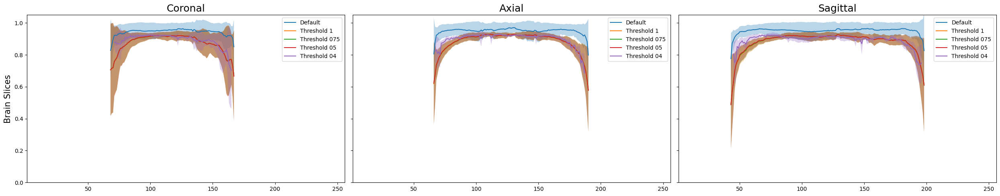

In [ ]:
# ssim_slices_mask = ssim_across_slices_scipy("/scratch/vinuyans/skips/sub-0003002", masked=True, share=True)
ssim_slices_nomask = ssim_across_slices_scipy("/scratch/vinuyans/skips", thresholds=['ieee', '1', '075', '05', '04'], subjects=['0003002', '0025011', '0025248', '0025350', '0025531'], masked=False, share=True)
pickle.dump(ssim_slices_mask, open('fondue_ssim_mask.pkl', 'wb'))

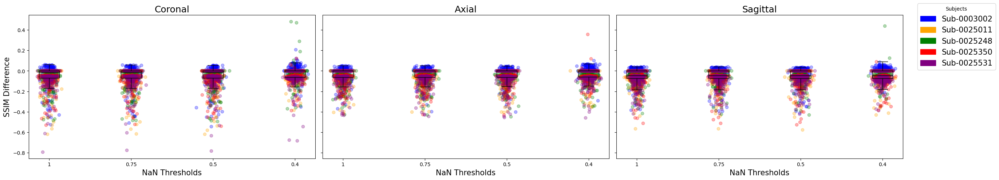

In [7]:
PROPS = {
    'boxprops': {'facecolor': 'none', 'edgecolor': 'black'},
    'medianprops': {'color': 'black'},
    'whiskerprops': {'color': 'black'},
    'capprops': {'color': 'black'}
}

# Load the SNR data
ssim_mask = pickle.load(open('/scratch/ine5/fastsurfer_embeddings/fastsurfer-embeddings/embedding_project/fondue_ssim_mask.pkl', 'rb'))

# Set up the plot with 3 subplots, one for each plane
fig, axes = plt.subplots(1, 3, figsize=(25, 5), sharey=True)

# Define subject colors
subject_colors = ['blue', 'orange', 'green', 'red', 'purple']  # Colors for each subject
subject_ids = ['0003002', '0025011', '0025248', '0025350', '0025531']  # Subject IDs

# Iterate over the planes
for num, plane in enumerate(['coronal', 'axial', 'sagittal']):

    # Store aggregated data for each threshold across all subjects
    threshold_data = []

    # Loop through thresholds (excluding IEEE as it is the baseline)
    for thresh in ['1', '075', '05', '04']:
        
        # Calculate SNR difference between each threshold and IEEE per subject
        ieee_values = np.array(ssim_mask[plane]['ieee'])  # Shape: (5, 256)
        thresh_values = np.array(ssim_mask[plane][thresh])  # Shape: (5, 256)
        snr_diff = thresh_values - ieee_values  # Shape: (5, 256)

        # Flatten snr_diff for all subjects and add to threshold_data
        threshold_data.append(snr_diff.flatten())

    threshold_data = np.nan_to_num(threshold_data)

    # Plot a single boxplot per threshold (aggregating all subjects)
    bplot = axes[num].boxplot(
        threshold_data.T,  # Aggregated data for each threshold
        positions=[1, 3, 5, 7],  # Position each threshold boxplot separately
        widths=0.5, patch_artist=True, showfliers=False, **PROPS)


    # Overlay scatter points for individual subject data
    for i, data in enumerate(threshold_data):
        for sub_idx in range(len(subject_ids)):
            y = data[sub_idx * 256:(sub_idx + 1) * 256]  # Data for one subject
            x = np.random.normal(loc=(i * 2 + 1), scale=0.1, size=len(y))  # Jitter points
            axes[num].scatter(x, y, alpha=0.3, color=subject_colors[sub_idx])

    # Set plot limits, labels, and title
    axes[num].set_title(plane.title(), fontsize=18)
    axes[num].set_xticks([1, 3, 5, 7])  # Position for each threshold
    axes[num].set_xticklabels(['1', '0.75', '0.5', '0.4'])
    axes[num].set_xlabel('NaN Thresholds', fontsize=15)

# Create custom legend for subjects
legend_patches = [mpatches.Patch(color=color, label=f'Sub-{sub_id}') for color, sub_id in zip(subject_colors, subject_ids)]
fig.legend(handles=legend_patches, loc='upper right', bbox_to_anchor=(1.1, 1), title='Subjects', fontsize=15)

# Configure the y-axis label
axes[0].set_ylabel('SSIM Difference', fontsize=15)

plt.tight_layout()
plt.show()
